# Advanced Lane Finding Project

 Camera Calibration and Lane Finding on Images 

##  Initialization

In [1]:
%matplotlib inline
# %matplotlib qt
%load_ext autoreload
%autoreload 2
import sys, os, pprint, pickle
import numpy as np
import cv2
import glob
# import matplotlib.pyplot as plt
# import matplotlib.image as mpimg



# from classes.camera import Camera
# from classes.line   import Line 
# from classes.image  import CalibrationImage
# from classes.plotting import PlotDisplay
# from common.utils   import *
# from common.utils import (perspectiveTransform, display_one
#                           colorLanePixels_v1, fit_polynomial_v1, plot_polynomial_v1, displayLaneRegion_v1, offCenterMsg_v1, displayGuidelines)
from common.pipelines import imagePipeline, saveOutputImage, loadCameraCalibration

from common.utils     import display_one, display_two

pp = pprint.PrettyPrinter(indent=2, width=100)
print('Current working dir: ', os.getcwd())
# pp.pprint(sys.path)
# if '..' not in sys.path:
#     print("appending '..' to sys.path")
#     sys.path.append('..')

## Load Calibration Images

sampleImages = glob.glob('./test_images/*.jpg')
sampleCount = len(sampleImages)
sampleIndexes = range(sampleCount)

print()
print(' Sample Image Filenames: ')
print(' ----------------------- ')
for fn in sampleImages:
    print('  ', fn)
print()

##  Load Camera Calibration Info

camera0 = loadCameraCalibration('./cameraConfig_0.pkl')

utils.py: appending '..' to sys.path
E:\Users\kevin\OneDrive\git_projs\CarND-Advanced-Lane-Lines
[ 'D:\\Anaconda3\\envs\\carnd-t1\\python36.zip',
  'D:\\Anaconda3\\envs\\carnd-t1\\DLLs',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib',
  'D:\\Anaconda3\\envs\\carnd-t1',
  '',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\win32',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\win32\\lib',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\Pythonwin',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\IPython\\extensions',
  'C:\\Users\\kevin\\.ipython',
  '..']
E:\Users\kevin\OneDrive\git_projs\CarND-Advanced-Lane-Lines
Current working dir:  E:\Users\kevin\OneDrive\git_projs\CarND-Advanced-Lane-Lines

 Sample Image Filenames: 
 ----------------------- 
   ./test_images\straight_lines1.jpg
   ./test_images\straight_lines2.jpg
   ./test_images\test1.jpg
   ./test_images\test2.jpg
   ./test_images\test3.jpg
   ./test_images

# Process Image --- Thresholding, Perspective Transformation, Lane detection 

In [11]:
from common.utils import *
from common.sobel import *
import matplotlib.image as mpimg
image_id = 2
image = mpimg.imread(sampleImages[image_id])
imgUndist = camera0.undistortImage(image)
mode  = 1

img Warped shape: (720, 1280, 3) 0 255


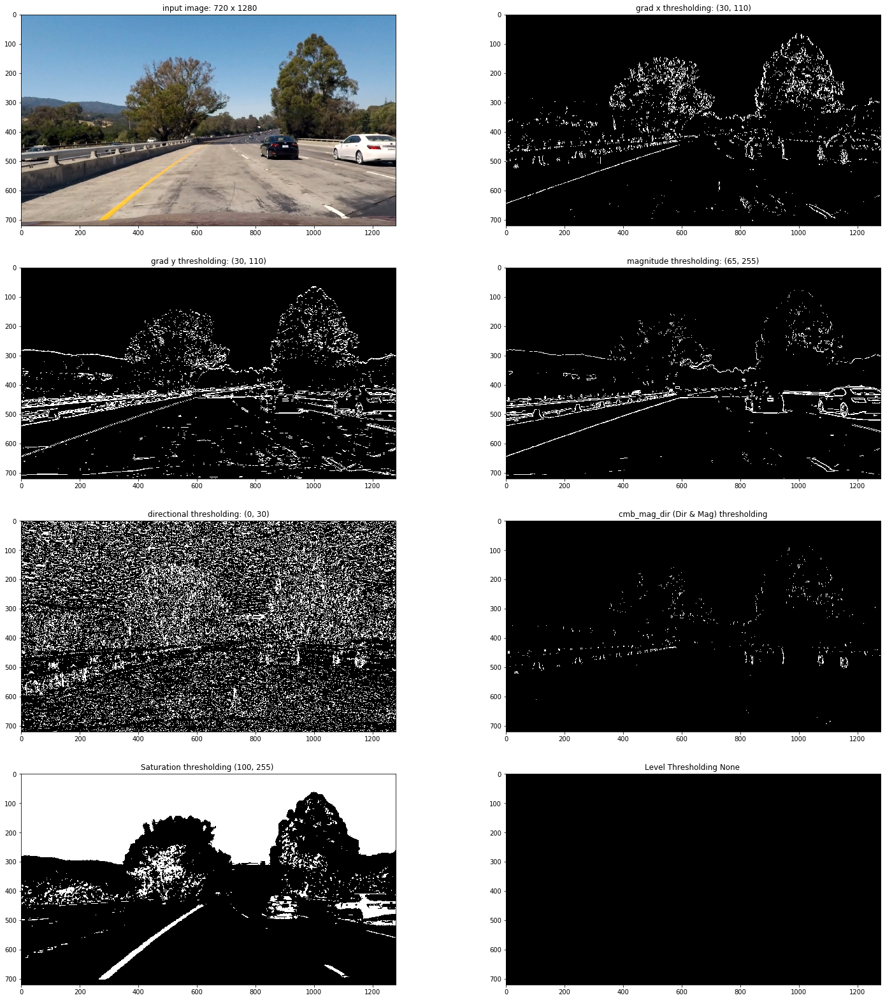

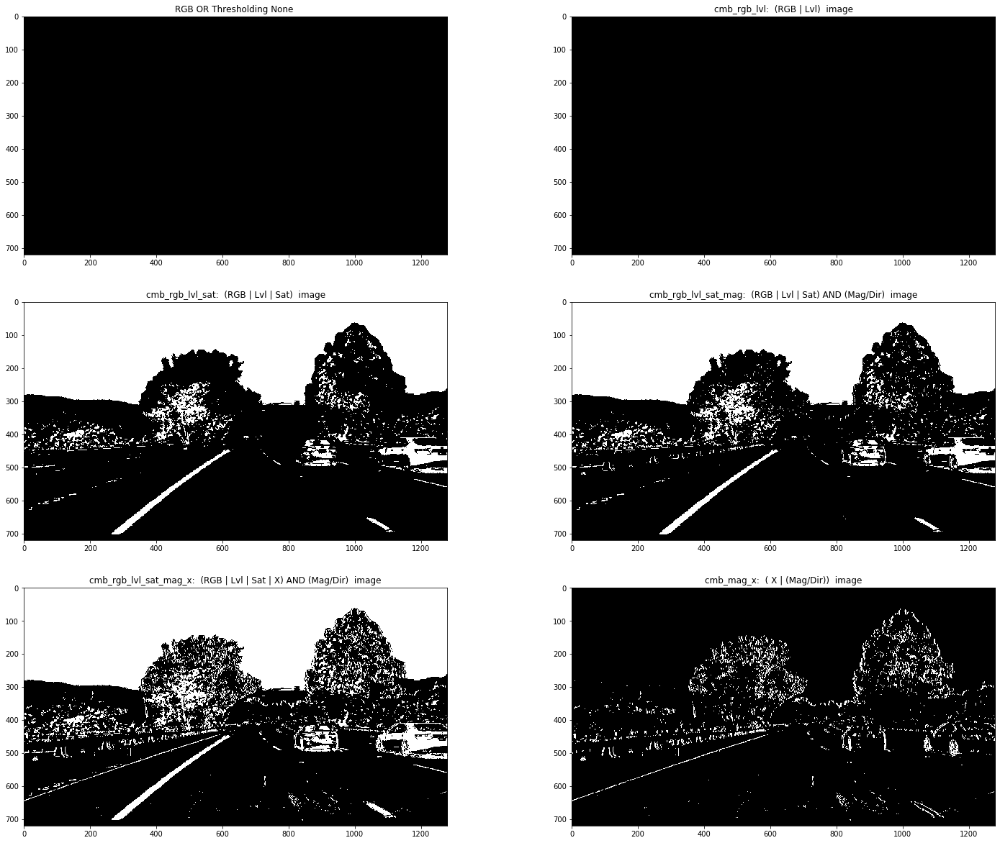

In [33]:
# ksize = 19 # Choose a larger odd number to smooth gradient measurements
# grad_x_thr = (70,100)
# grad_y_thr = (80,155)
# mag_thr    = (90,160)
ksize        = 5
x_thr        = (30,110)
y_thr        = (30,110)
mag_thr      = (65,255)
dir_thr      = (0,30)
sat_thr      = (100,255)


height, width, _   = image.shape
camera_x           = width //2
camera_y           = height

# RoI_x_top_left  = camera_x - 65
# RoI_x_top_right = camera_x + 65
# RoI_x_bot_left  = camera_x - 470
# RoI_x_bot_right = camera_x + 490
# RoI_y_bot       = image.shape[0] - 20
# RoI_y_top       = RoI_y_bot - 260

# print(' Y bottom: ', RoI_y_bot, '   y_top : ', RoI_y_top)
# RoI_vertices_list = [(RoI_x_bot_left , RoI_y_bot), 
#                      (RoI_x_top_left , RoI_y_top), 
#                      (RoI_x_top_right, RoI_y_top), 
#                      (RoI_x_bot_right, RoI_y_bot)]
# RoI_vertices      = np.array([RoI_vertices_list],dtype = np.int32)

# src_points = np.array([ ( 611, RoI_y_top), 
#                         ( 666, RoI_y_top), 
#                         (1055, RoI_y_bot), 
#                          (250, RoI_y_bot)],dtype = np.float32)

# src_points = np.array([ ( 568, RoI_y_top), 
#                         ( 723, RoI_y_top), 
#                         (1090, RoI_y_bot), 
#                         ( 215, RoI_y_bot)],dtype = np.float32)

# dst_points = np.array([ (x_transform_left,    2), 
#                         (x_transform_right,   2), 
#                         (x_transform_right, 718), 
#                         (x_transform_left,  718)],dtype = np.float32)

# src_points = np.array([ ( 595, RoI_y_top),
#                         ( 690, RoI_y_top),
#                         (1087, RoI_y_bot),         ### was 692
#                         ( 228, RoI_y_bot)],dtype = np.float32)   ### was 705

## Original for image_id 2----------------------------------------------------------
x_src_top_left  =  608
x_src_top_right =  675
x_src_bot_left  =  228 
x_src_bot_right = 1087 

y_src_top   = 440
y_src_bot   = 700

x_dst_left  = 290
x_dst_right = 990
y_dst_top   = 0 
y_dst_bot   = height - 1
##---------------------------------------------------------------------------------


## Original for image_id 2----------------------------------------------------------
x_src_top_left  =  615
x_src_top_right =  715
x_src_bot_left  =  245
x_src_bot_right = 1135

y_src_top   = 440
y_src_bot   = 700

x_dst_left  = 290
x_dst_right = 990
y_dst_top   = 0 
y_dst_bot   = height - 1
##---------------------------------------------------------------------------------


warpedRoIVertices_list = [(x_dst_left-2 , y_dst_top), 
                          (x_dst_right+2, y_dst_top), 
                          (x_dst_right+2, y_dst_bot), 
                          (x_dst_left-2 , y_dst_bot)]
warpedRoIVertices = np.array([warpedRoIVertices_list],dtype = np.int32)

src_points_list = [ (x_src_top_left , y_src_top),
                        (x_src_top_right, y_src_top),
                        (x_src_bot_right, y_src_bot),      
                        (x_src_bot_left , y_src_bot)]

src_points = np.array([src_points_list],dtype = np.float32)  

dst_points_array = [ (x_dst_left,  y_dst_top), 
                        (x_dst_right, y_dst_top), 
                        (x_dst_right, y_dst_bot), 
                        (x_dst_left,  y_dst_bot)]

dst_points = np.array([ dst_points_array],dtype = np.float32)


###----------------------------------------------------------------------------------------------
### 
###----------------------------------------------------------------------------------------------
imgWarped, M, Minv = perspectiveTransform(imgUndist, src_points, dst_points, debug = False)
print('img Warped shape:', imgWarped.shape, imgWarped.min(), imgWarped.max())



imgThrshldDict = apply_thresholds_v1(imgUndist, ksize=ksize, x_thr = x_thr, y_thr = y_thr, 
                               mag_thr = mag_thr, dir_thr = dir_thr, sat_thr = sat_thr, debug = True)

 key: cmb_xy                            shape: (720, 1280)    min: 0   max: 1 
 key: cmb_rgb_lvl                       shape: (720, 1280)    min: 0   max: 0 
 key: cmb_rgb_lvl_sat                   shape: (720, 1280)    min: 0   max: 1 
 key: cmb_rgb_lvl_sat_mag               shape: (720, 1280)    min: 0   max: 1 
 key: cmb_rgb_lvl_sat_mag_x             shape: (720, 1280)    min: 0   max: 1 
 key: cmb_mag_x                         shape: (720, 1280)    min: 0   max: 1 
 key: cmb_sat                           shape: (720, 1280)    min: 0   max: 1 
 key: cmb_lvl                           shape: (720, 1280)    min: 0   max: 0 


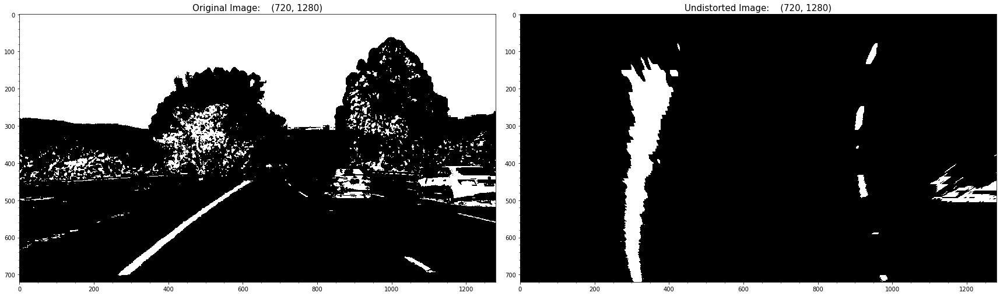

In [34]:
for i,v in imgThrshldDict.items():
    print(' key: {:30s}    shape: {}    min: {}   max: {} '.format(i, v.shape, v.min(), v.max()))

thresholdKey = 'cmb_rgb_lvl_sat'
imgThrshld = imgThrshldDict[thresholdKey]
imgThrshldWarped, M, Minv = perspectiveTransform(imgThrshld, src_points, dst_points, debug = False)

# hist, reg, leftx, rightx = pixelHistogram(imgThrshld, y_src_bot-30, y_src_bot+4 , x_src_bot_left - 30, x_src_top_right + 30)
# display_two(hist, reg, size = (25,5))

# hist, reg, leftx, rightx = pixelHistogram(imgThrshld, y_src_top-4, y_src_top+30, x_src_top_left - 30, x_src_top_right + 30)
# display_two(hist, reg, size = (25,5))

display_two(imgThrshld, imgThrshldWarped)

img_roi shape: (720, 1280, 3) 0 255
imgMaskedDebug shape: (720, 1280, 3) 0 255
 Mode 1: Threshold Image --> Warp 


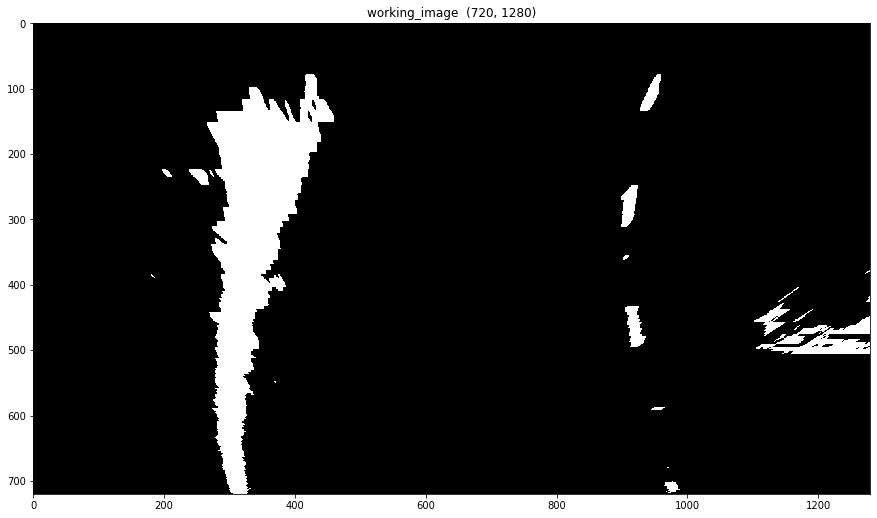

 histogram shape before padding:  (1280,)
 histogram shape after padding :  (1280,)
 Run find_lane_pixels()  - histRange: None
 Midpoint (histogram//2): 640 
 Histogram left side max: 306  right side max: 561
 Histogram left side max: 306  right side max: 1201
 left x base       :  306   right x base : 1201
 window_height     :  80
 nonzero x count   :  59742
 nonzero y count   :  59742
 Starting Positions: left x : 306   right x:  1201

 Window:  0  y range:  640  to  720
--------------------------------------------------
 Left  lane X range :  206   to   406
 Right lane X range :  1101   to   1301

 left_x_inds  :  (46185,)  left_y_indx  :  (2825,)  -- good left inds size:  2564
 right_x_inds :  (5654,)  right_y_indx :  (2825,)   -- good right inds size:  0
 Set leftx_current  :  306 ---> 307 
 Keep rightx_current:  1201 

 Window:  1  y range:  560  to  640
--------------------------------------------------
 Left  lane X range :  207   to   407
 Right lane X range :  1101   to   130

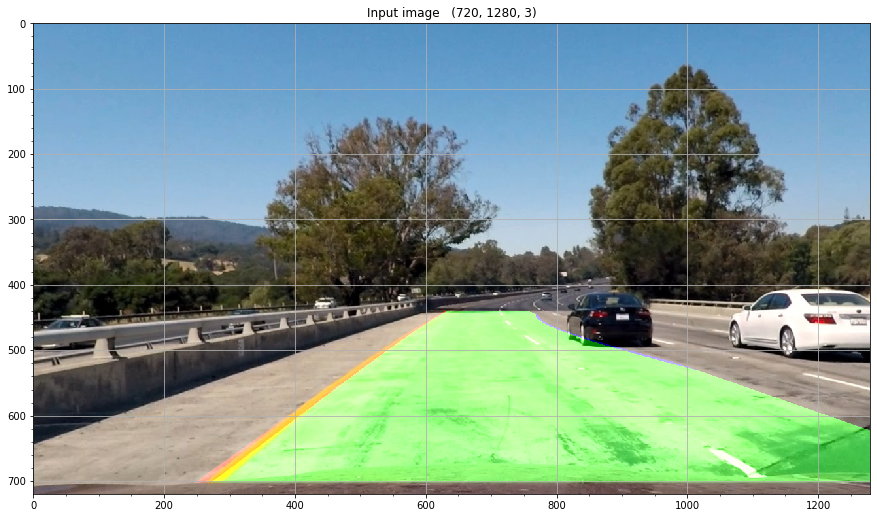

   y eval   avg pxl    left_pxl   right_pxl 
      700     402.06     723.86      80.26 
Curvature  L: 723 m  R: 80 m
Curvature  L: 723 m  R: 80 m


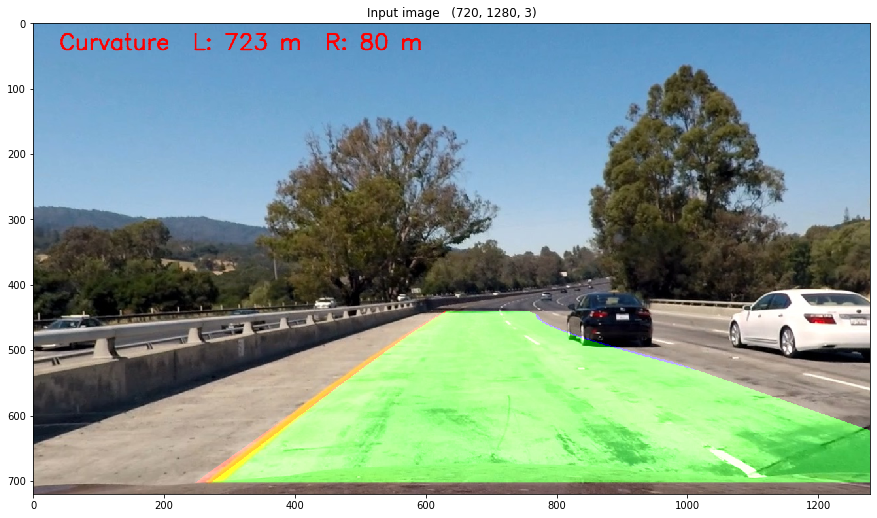

Y:  700  Left lane:  304.289  right_lane: 1432.330  midpt:  868.289  off_center:  228.289 , off_center(mtrs):    1.207 
1.207 m left of lane center


In [27]:
imgWarpedThrshldDict  = apply_thresholds_v1(imgWarped, ksize=ksize, 
                                     x_thr = x_thr, y_thr = y_thr, 
                                   mag_thr = (50,255), dir_thr = (0,10), 
                                   sat_thr = (80, 255), debug = False)
imgWarpedThrshld =  imgWarpedThrshldDict[thresholdKey]



img_roi   = displayRoILines(imgUndist, src_points_list)
imgMaskedDebug = region_of_interest(img_roi, src_points.astype(np.int32))
print('img_roi shape:', img_roi.shape, img_roi.min(), img_roi.max())
print('imgMaskedDebug shape:', imgMaskedDebug.shape, imgMaskedDebug.min(), imgMaskedDebug.max())

# pp                = region_of_interest(undistImg, RoI_vertices)
imgWarpedDebug, _, _ = perspectiveTransform(img_roi, src_points, dst_points, debug = False)
imgWarpedDebug_wRoILines    = displayRoILines(imgWarpedDebug, warpedRoIVertices_list, color = 'green')


################################################################################################
### Select image we want to process further 
################################################################################################
if mode == 1:
    print(' Mode 1: Threshold Image --> Warp ' )
    working_image = imgThrshldWarped; sfx = '_thr_wrp'   ### Warped AFTER thresholding
else:
    print(' Mode 2: Warp Image  --> Thresholding ' )
    working_image = imgWarpedThrshld; sfx = '_wrp_thr'   ### Warped BEFORE thresholding

display_one(working_image, title = 'working_image')

leftx, lefty, rightx, righty, out_img, histogram = find_lane_pixels_v1(working_image, debug = True)

# imgLanePixels = display_lane_pixels(out_img, leftx, lefty, rightx, righty)
imgLanePixels = colorLanePixels_v1(out_img, leftx, lefty, rightx, righty)

left_fit, right_fit = fit_polynomial_v1(leftx, lefty, rightx, righty);

ploty, left_fitx, right_fitx = plot_polynomial_v1(imgLanePixels.shape[0], left_fit, right_fit)

print('  input_img : ', working_image.min(), working_image.max())
print('  output_img: ', imgLanePixels.min(), imgLanePixels.max())

result_1 = displayLaneRegion_v1(imgUndist, left_fitx, right_fitx, Minv)
display_one(result_1, grid = 'major')

curv_msg, _ , _ , _  = measure_curvature(700, left_fit, right_fit, 'm', debug = True)
print(curv_msg)

result_2 = displayText(result_1, 40,40, curv_msg, fontHeight = 25)
display_one(result_2)

plot_index = -20
oc_msg = offCenterMsg_v1(ploty[plot_index], left_fitx[plot_index], right_fitx[plot_index], camera_x, debug = True)
print(oc_msg)

result_2 = displayText(result_2, 40,80, oc_msg, fontHeight = 25)
displayGuidelines(result_2, draw = 'y');

(240, 1280)


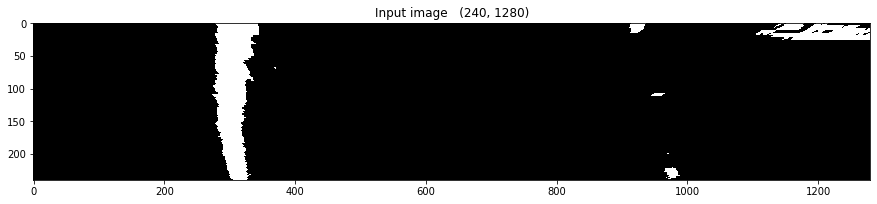

In [30]:
pp = working_image[2*working_image.shape[0]//3:, 0:working_image.shape[1]]
print(pp.shape)
display_one(pp)

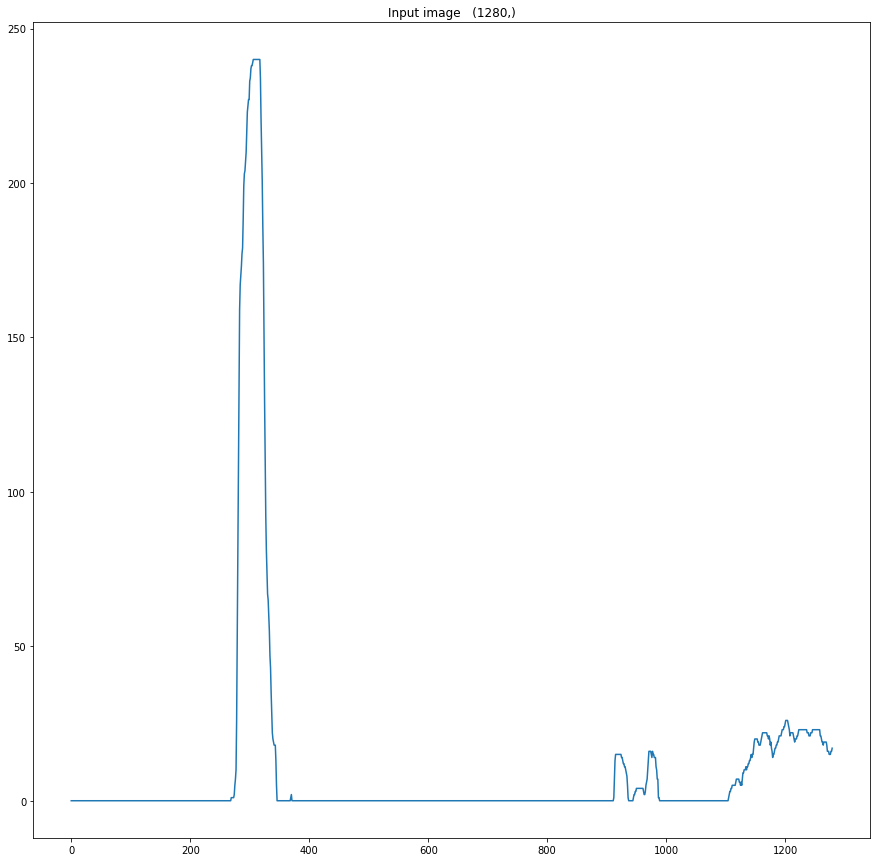

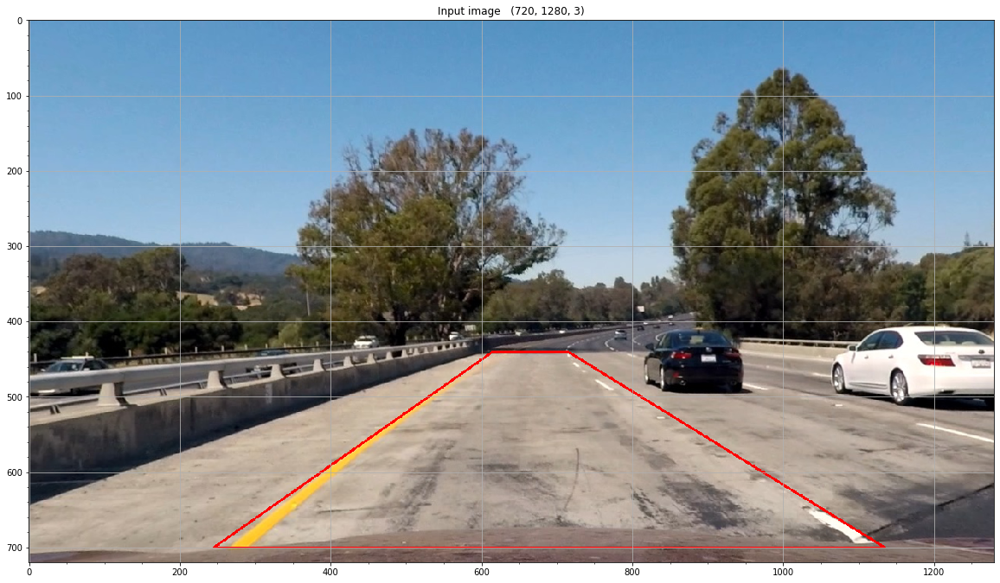

In [21]:
display_one(histogram)
display_one(img_roi, grid = 'major', size = 20)

In [23]:
from classes.plotting import PlotDisplay

E:\Users\kevin\OneDrive\git_projs\CarND-Advanced-Lane-Lines\classes\plotting.py:55: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = self.add_subplot(self.rows, self.cols, subplot)


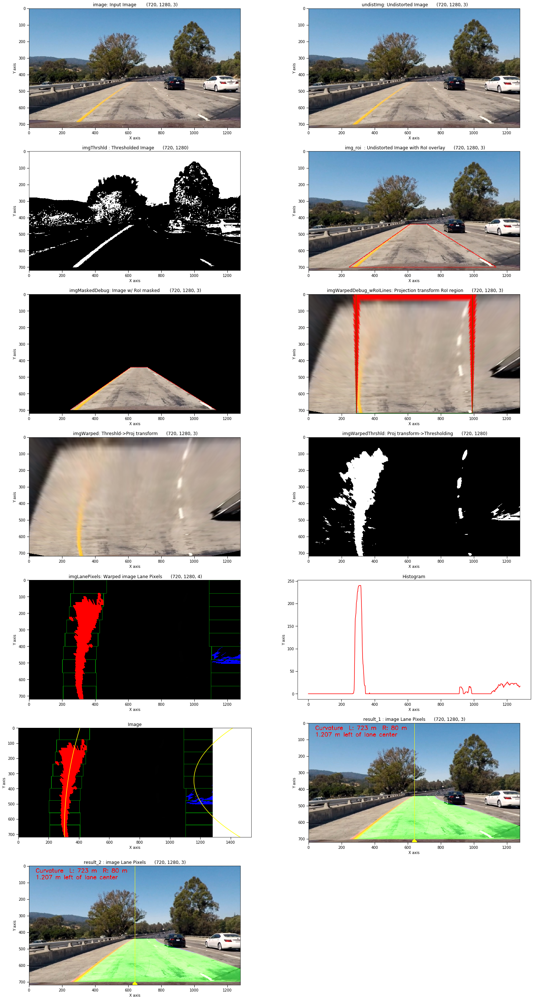

<Figure size 1800x4032 with 0 Axes>

In [26]:
disp  = PlotDisplay(8,2)

disp.addPlot(image              , title = ' image: Input Image ' )
disp.addPlot(imgUndist          , title = ' undistImg: Undistorted Image')

disp.addPlot(imgThrshld         , title = ' imgThrshld : Thresholded Image')
disp.addPlot(img_roi            , title = ' img_roi  : Undistorted Image with RoI overlay')

disp.addPlot(imgMaskedDebug     , title = ' imgMaskedDebug: Image w/ RoI masked ')
disp.addPlot(imgWarpedDebug_wRoILines, title = ' imgWarpedDebug_wRoILines: Projection transform RoI region')

# disp.addPlot(imgMasked     , title = ' imgMasked: Thresholded Image w/ RoI masked')
disp.addPlot(imgWarped           , title = ' imgWarped: Threshld->Proj transform')
disp.addPlot(imgWarpedThrshld    , title = ' imgWarpedThrshld: Proj transform->Thresholding')

disp.addPlot(imgLanePixels       , title = ' imgLanePixels: Warped image Lane Pixels')
disp.addPlot(histogram, title= 'Histogram', type = 'plot' )

# disp2.addPlot(working_image)  ## same as imgWarped
disp.addPlot(imgLanePixels, title='image Lane Pixels')
disp.addPlot(left_fitx    , ploty,  subplot = disp.subplot, type = 'plot', color = 'yellow')
disp.addPlot(right_fitx   , ploty,  subplot = disp.subplot, type = 'plot', color = 'yellow')
disp.addPlot(result_1, title='result_1 : image Lane Pixels')
disp.addPlot(result_2, title='result_2 : image Lane Pixels')

disp.closePlot()

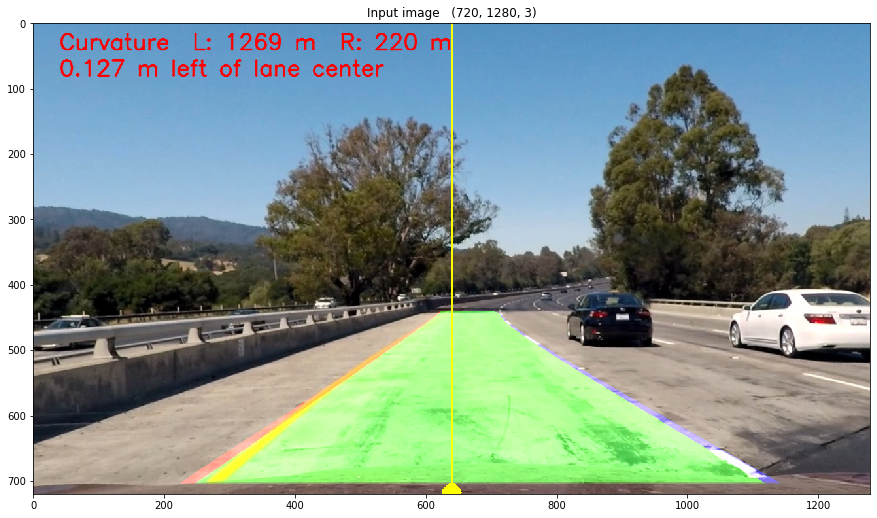

In [85]:
display_one(result_2)

In [47]:
filename_ext = os.path.basename(sampleImages[image_id])
filename = os.path.splitext(filename_ext)
rc = mpimg.imsave('./output_images/'+filename[0]+'_output'+filename[1], result_3)
print(rc)

straight_lines1.jpg
('straight_lines1', '.jpg')
None


#### Curvature calculations 

In [86]:
print("  {:8s}  {:8s}   {:8s}   {:8s}      {:8s}   {:8s}  {:8s} ".format(" y eval" ,"avg pxl", "left_pxl" , "right_pxl", "avg mtr","left_mtr", "right_mtr"))
print('-'*80)
for y_eval in range(20,730,50):
    msg, curv_avg_pxl, curv_left_pxl, curv_right_pxl = measure_curvature(y_eval, left_fit, right_fit, 'p')
    msg, curv_avg_mtr, curv_left_mtr, curv_right_mtr = measure_curvature(y_eval, left_fit, right_fit, 'm')
    print(" {:8.0f}   {:8.2f}   {:8.2f}   {:8.2f}      {:8.2f}   {:8.2f}   {:8.2f} ".format(y_eval, 
                                                                                            curv_avg_pxl, curv_left_pxl, curv_right_pxl, 
                                                                                            curv_avg_mtr, curv_left_mtr, curv_right_mtr))

   y eval   avg pxl    left_pxl   right_pxl      avg mtr    left_mtr  right_mtr 
--------------------------------------------------------------------------------
       20    3016.44    3931.41    2101.46        746.61    1267.40     225.82 
       70    3011.91    3932.12    2091.70        746.26    1267.50     225.02 
      120    3007.41    3932.84    2081.99        745.94    1267.61     224.28 
      170    3002.94    3933.56    2072.32        745.66    1267.73     223.60 
      220    2998.48    3934.28    2062.69        745.42    1267.86     222.98 
      270    2994.05    3935.00    2053.10        745.21    1268.00     222.42 
      320    2989.65    3935.73    2043.56        745.03    1268.15     221.92 
      370    2985.26    3936.47    2034.06        744.89    1268.31     221.47 
      420    2980.90    3937.20    2024.60        744.79    1268.48     221.09 
      470    2976.57    3937.94    2015.19        744.72    1268.66     220.77 
      520    2972.25    3938.68    200

# Process Image II -- Thresholding, Perspective Transformation, Lane detection 

In [55]:
from common.utils import *
from common.sobel import *
import matplotlib.image as mpimg
image_id = 2
image = mpimg.imread(sampleImages[image_id])
imgUndist = camera0.undistortImage(image)

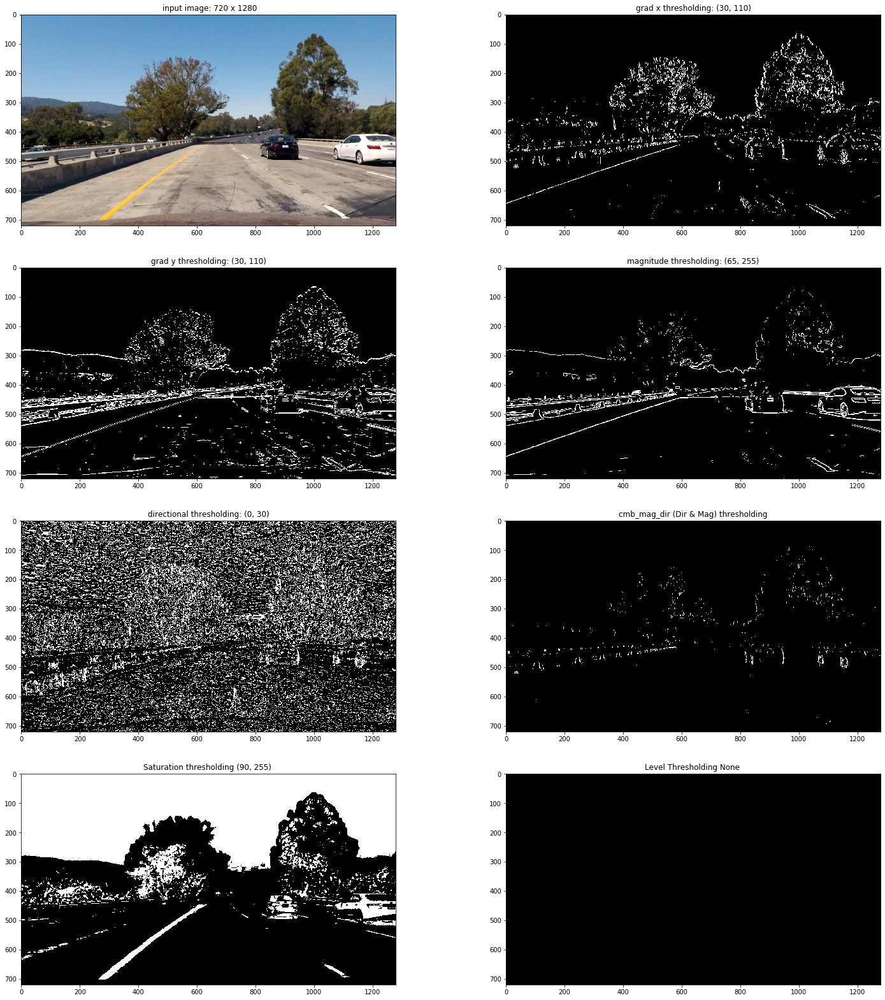

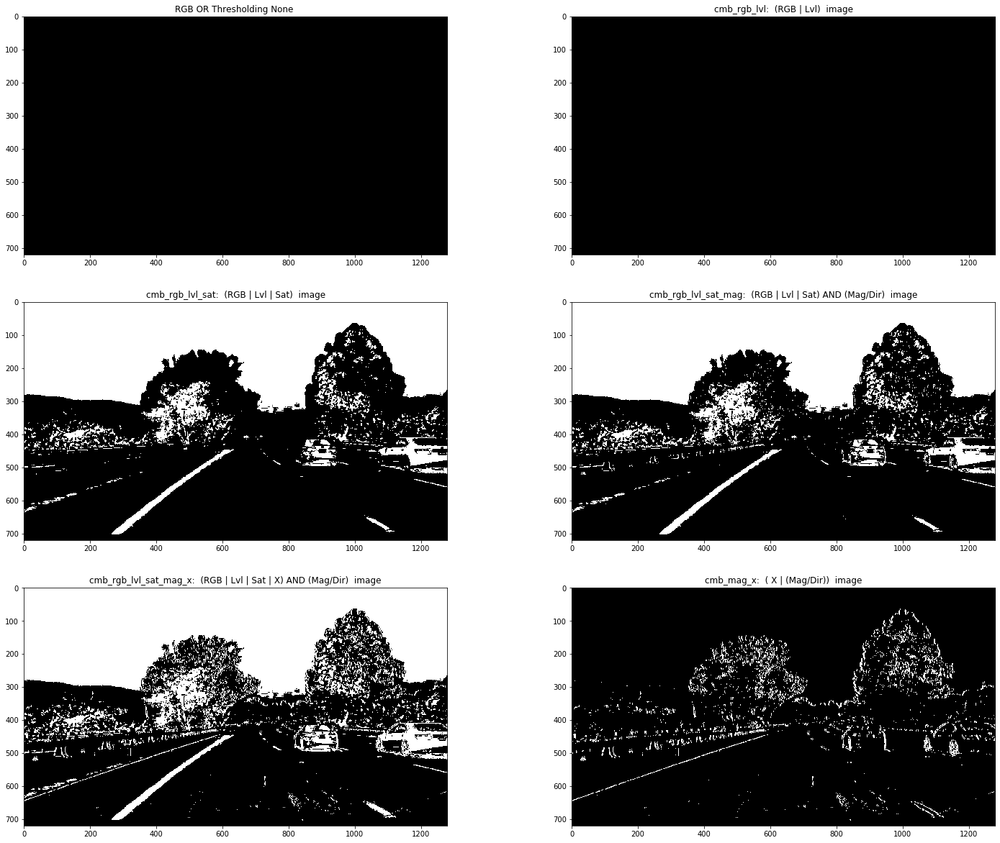

 key: cmb_xy                            shape: (720, 1280)    min: 0   max: 1 
 key: cmb_rgb_lvl                       shape: (720, 1280)    min: 0   max: 0 
 key: cmb_rgb_lvl_sat                   shape: (720, 1280)    min: 0   max: 1 
 key: cmb_rgb_lvl_sat_mag               shape: (720, 1280)    min: 0   max: 1 
 key: cmb_rgb_lvl_sat_mag_x             shape: (720, 1280)    min: 0   max: 1 
 key: cmb_mag_x                         shape: (720, 1280)    min: 0   max: 1 
 key: cmb_sat                           shape: (720, 1280)    min: 0   max: 1 
 key: cmb_lvl                           shape: (720, 1280)    min: 0   max: 0 


In [64]:
# ksize = 19 # Choose a larger odd number to smooth gradient measurements
# grad_x_thr = (70,100)
# grad_y_thr = (80,155)
# mag_thr    = (90,160)
ksize        = 5
x_thr        = (30,110)
y_thr        = (30,110)
mag_thr      = (65,255)
dir_thr      = (0,30)
sat_thr      = (90,255)


height, width, _   = image.shape
camera_x           = width //2
camera_y           = height

# RoI_x_top_left  = camera_x - 65
# RoI_x_top_right = camera_x + 65
# RoI_x_bot_left  = camera_x - 470
# RoI_x_bot_right = camera_x + 490
# RoI_y_bot       = image.shape[0] - 20
# RoI_y_top       = RoI_y_bot - 260

# print(' Y bottom: ', RoI_y_bot, '   y_top : ', RoI_y_top)
# RoI_vertices_list = [(RoI_x_bot_left , RoI_y_bot), 
#                      (RoI_x_top_left , RoI_y_top), 
#                      (RoI_x_top_right, RoI_y_top), 
#                      (RoI_x_bot_right, RoI_y_bot)]
# RoI_vertices      = np.array([RoI_vertices_list],dtype = np.int32)
# warpedRoIVertices_list = [(x_transform_left-2 , 0), 
#                           (x_transform_right+2, 0), 
#                           (x_transform_right+2, height-1), 
#                           (x_transform_left-2 , height-1)]
# warpedRoIVertices = np.array([warpedRoIVertices_list],dtype = np.int32)
 
# src_points = np.array([ ( 611, RoI_y_top), 
#                         ( 666, RoI_y_top), 
#                         (1055, RoI_y_bot), 
#                          (250, RoI_y_bot)],dtype = np.float32)

# src_points = np.array([ ( 568, RoI_y_top), 
#                         ( 723, RoI_y_top), 
#                         (1090, RoI_y_bot), 
#                         ( 215, RoI_y_bot)],dtype = np.float32)

# dst_points = np.array([ (x_transform_left,    2), 
#                         (x_transform_right,   2), 
#                         (x_transform_right, 718), 
#                         (x_transform_left,  718)],dtype = np.float32)

# src_points = np.array([ ( 595, RoI_y_top),
#                         ( 690, RoI_y_top),
#                         (1087, RoI_y_bot),         ### was 692
#                         ( 228, RoI_y_bot)],dtype = np.float32)   ### was 705

x_src_top_left  =  608
x_src_top_right =  675
x_src_bot_left  =  228 
x_src_bot_right = 1087 
y_src_top   = 440
y_src_bot   = 700

x_dst_left  = 290
x_dst_right = 990
y_dst_top   = 0 
y_dst_bot   = height - 1

warpedRoIVertices_list = [(x_dst_left-2 , y_dst_top), 
                          (x_dst_right+2, y_dst_top), 
                          (x_dst_right+2, y_dst_bot), 
                          (x_dst_left-2 , y_dst_bot)]
warpedRoIVertices = np.array([warpedRoIVertices_list],dtype = np.int32)


src_points = np.array([ (x_src_top_left , y_src_top),
                        (x_src_top_right, y_src_top),
                        (x_src_bot_right, y_src_bot),      
                        (x_src_bot_left , y_src_bot)],dtype = np.float32)  

dst_points = np.array([ (x_dst_left,  y_dst_top), 
                        (x_dst_right, y_dst_top), 
                        (x_dst_right, y_dst_bot), 
                        (x_dst_left,  y_dst_bot)],dtype = np.float32)

imgThrshld = apply_thresholds_v1(imgUndist, ksize=ksize, x_thr = x_thr, y_thr = y_thr, 
                               mag_thr = mag_thr, dir_thr = dir_thr, sat_thr = sat_thr, debug = True)

for i,v in imgThrshld.items():
    print(' key: {:30s}    shape: {}    min: {}   max: {} '.format(i, v.shape, v.min(), v.max()))

    
    
    
    
# imgThrshld = apply_thresholds_v2(imgUndist, ksize=ksize, x_thr = grad_x_thr, y_thr = grad_y_thr, 
#                                mag_thr = mag_thr, dir_thr = dir_thr, sat_thr = sat_thr, debug = True)

# for i,v in imgThrshld.items():
#     print(' key: {:30s}    shape: {}    min: {}   max: {} '.format(i, v.shape, v.min(), v.max()))



In [66]:

thresholdKey = 'cmb_rgb_lvl_sat'    
hist, reg, leftx, rightx = pixelHistogram(imgThrshld[thresholdKey], RoI_y_bot-30, RoI_y_bot+4 , RoI_x_bot_left - 30, RoI_x_top_right + 30)
display_two(hist, reg, size = (25,5))

hist, reg, leftx, rightx = pixelHistogram(imgThrshld[thresholdKey], RoI_y_top-4, RoI_y_top+20, RoI_x_top_left - 30, RoI_x_top_right + 30)
display_two(hist, reg, size = (25,5))

display_one(imgThrshld[thresholdKey])

NameError: name 'RoI_y_bot' is not defined

In [ ]:
## Warp Thresholded image
imgWarped, M, Minv = perspectiveTransform(imgThrshld[thresholdKey], src_points, dst_points, debug = False)
print('img Thresholded --> Warped shape:', imgWarped.shape, imgWarped.min(), imgWarped.max())

In [75]:
img_roi   = displayRoILines(imgUndist, RoI_vertices_list)
print('img_roi shape:', img_roi.shape, img_roi.min(), img_roi.max())

# imgMasked = region_of_interest(imgThrshld[-1], RoI_vertices)
# print('img Masked shape:', imgMasked.shape, imgMasked.min(), imgMasked.max())


## masked RoI region 
imgMaskedDebug = region_of_interest(img_roi, RoI_vertices)
print('imgMaskedDebug shape:', imgMaskedDebug.shape, imgMaskedDebug.min(), imgMaskedDebug.max())

# pp                = region_of_interest(undistImg, RoI_vertices)
imgWarpedDebug, _, _ = perspectiveTransform(imgUndist, src_points, dst_points, debug = False)
imgWarpedThrshld  = apply_thresholds_v2(imgWarpedDebug, ksize=ksize, 
                                     x_thr = grad_x_thr, y_thr = grad_y_thr, 
                                   mag_thr = (50,255), dir_thr = (0,10), 
                                   sat_thr = (80, 255), debug = False)
imgWarpedDebug_wRoILines    = displayRoILines(imgWarpedDebug, warpedRoIVertices_list)


img Warped shape: (720, 1280) 0.0 1.0
img_roi shape: (720, 1280, 3) 0 255
imgMaskedDebug shape: (720, 1280, 3) 0 255


In [78]:
################################################################################################
### Select image we want to process further 
################################################################################################
working_image = imgWarped
# working_image = imgWarpedThrshld[-1]

leftx, lefty, rightx, righty, out_img, histogram = find_lane_pixels_v1(working_image, debug = False)

# imgLanePixels = display_lane_pixels(out_img, leftx, lefty, rightx, righty)
imgLanePixels = colorLanePixels_v1(out_img, leftx, lefty, rightx, righty)

left_fit, right_fit = fit_polynomial_v1(leftx, lefty, rightx, righty);

ploty, left_fitx, right_fitx = plot_polynomial_v1(imgLanePixels.shape[0], left_fit, right_fit)

print('  input_img : ', working_image.min(), working_image.max())
print('  output_img: ', imgLanePixels.min(), imgLanePixels.max())

result_1 = displayLaneRegion_v1(imgUndist, left_fitx, right_fitx, Minv)
display_one(result_1, grid = 'major')

curv_msg, _ , _ , _  = measure_curvature(700, left_fit, right_fit, 'm', debug = True)
print(curv_msg)

result_2 = displayText(result_1, 40,40, curv_msg, fontHeight = 25)
display_one(result_2)

plot_index = -20
oc_msg = offCenterMsg_v1(ploty[plot_index], left_fitx[plot_index], right_fitx[plot_index], camera_x, debug = True)
print(oc_msg)

result_2 = displayText(result_2, 40,80, oc_msg, fontHeight = 25)
displayGuidelines(result_2, draw = 'y');

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
E:\Users\kevin\OneDrive\git_projs\CarND-Advanced-Lane-Lines\classes\plotting.py:55: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  ax = self.add_subplot(self.rows, self.cols, subplot)


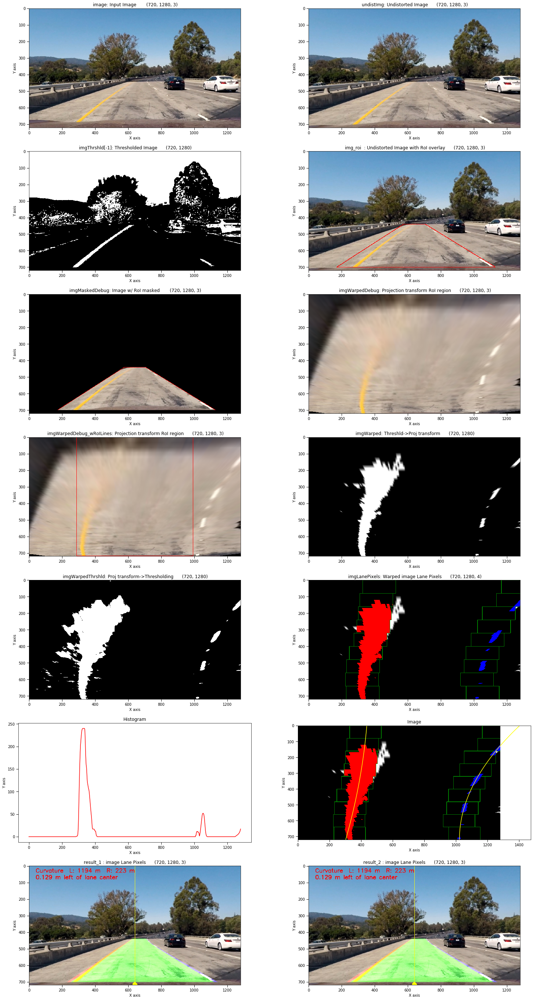

<Figure size 1800x4032 with 0 Axes>

In [95]:
disp  = PlotDisplay(8,2)

disp.addPlot(image              , title = ' image: Input Image ' )
disp.addPlot(imgUndist          , title = ' undistImg: Undistorted Image')
disp.addPlot(imgThrshld[thresholdKey]     , title = ' imgThrshld[-1]: Thresholded Image')
disp.addPlot(img_roi            , title = ' img_roi  : Undistorted Image with RoI overlay')
disp.addPlot(imgMaskedDebug     , title = ' imgMaskedDebug: Image w/ RoI masked ')
disp.addPlot(imgWarpedDebug     , title = ' imgWarpedDebug: Projection transform RoI region')
disp.addPlot(imgWarpedDebug_wRoILines, title = ' imgWarpedDebug_wRoILines: Projection transform RoI region')
# disp.addPlot(imgMasked     , title = ' imgMasked: Thresholded Image w/ RoI masked')
disp.addPlot(imgWarped           , title = ' imgWarped: Threshld->Proj transform')
disp.addPlot(imgWarpedThrshld[thresholdKey], title = ' imgWarpedThrshld: Proj transform->Thresholding')

disp.addPlot(imgLanePixels       , title = ' imgLanePixels: Warped image Lane Pixels')
disp.addPlot(histogram, title= 'Histogram', type = 'plot' )

# disp2.addPlot(working_image)  ## same as imgWarped
disp.addPlot(imgLanePixels, title='image Lane Pixels')
disp.addPlot(left_fitx    , ploty,  subplot = disp.subplot, type = 'plot', color = 'yellow')
disp.addPlot(right_fitx   , ploty,  subplot = disp.subplot, type = 'plot', color = 'yellow')
disp.addPlot(result_1, title='result_1 : image Lane Pixels')
disp.addPlot(result_2, title='result_2 : image Lane Pixels')

disp.closePlot()

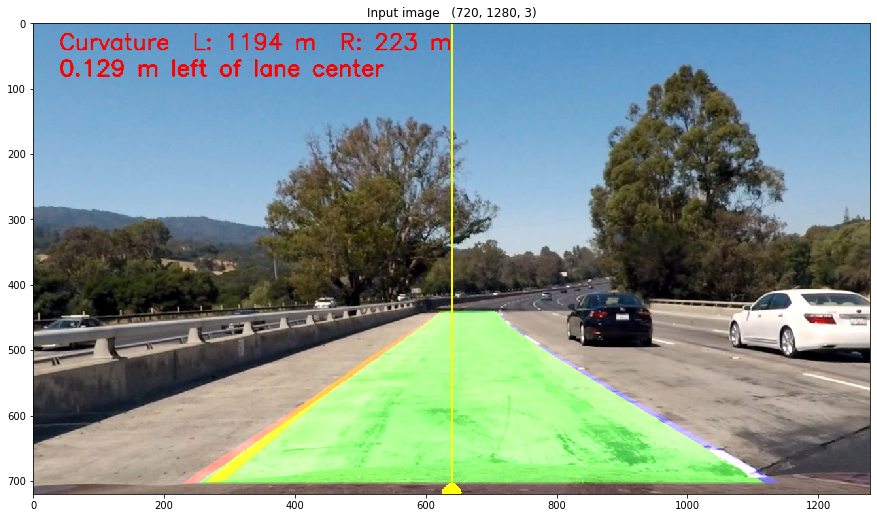

In [97]:
display_one(result_2)

In [47]:
filename_ext = os.path.basename(sampleImages[image_id])
filename = os.path.splitext(filename_ext)
rc = mpimg.imsave('./output_images/'+filename[0]+'_output'+filename[1], result_3)
print(rc)

straight_lines1.jpg
('straight_lines1', '.jpg')
None


## Curvature calculations 

In [99]:
print("  {:8s}  {:8s}   {:8s}   {:8s}      {:8s}   {:8s}  {:8s} ".format(" y eval" ,"avg pxl", "left_pxl" , "right_pxl", "avg mtr","left_mtr", "right_mtr"))
print('-'*80)
for y_eval in range(20,730,50):
    msg, curv_avg_pxl, curv_left_pxl, curv_right_pxl = measure_curvature(y_eval, left_fit, right_fit, 'p')
    msg, curv_avg_mtr, curv_left_mtr, curv_right_mtr = measure_curvature(y_eval, left_fit, right_fit, 'm')
    print(" {:8.0f}   {:8.2f}   {:8.2f}   {:8.2f}      {:8.2f}   {:8.2f}   {:8.2f} ".format(y_eval, 
                                                                                            curv_avg_pxl, curv_left_pxl, curv_right_pxl, 
                                                                                            curv_avg_mtr, curv_left_mtr, curv_right_mtr))

E:\Users\kevin\OneDrive\git_projs\CarND-Advanced-Lane-Lines
[ 'D:\\Anaconda3\\envs\\carnd-t1\\python36.zip',
  'D:\\Anaconda3\\envs\\carnd-t1\\DLLs',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib',
  'D:\\Anaconda3\\envs\\carnd-t1',
  '',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\win32',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\win32\\lib',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\Pythonwin',
  'D:\\Anaconda3\\envs\\carnd-t1\\lib\\site-packages\\IPython\\extensions',
  'C:\\Users\\kevin\\.ipython',
  '..']
   y eval   avg pxl    left_pxl   right_pxl      avg mtr    left_mtr  right_mtr 
--------------------------------------------------------------------------------
       20    2883.07    3671.39    2094.74        711.05    1192.76     229.35 
       70    2878.55    3671.93    2085.16        710.70    1192.84     228.56 
      120    2874.05    3672.48    2075.63        710.38    1192.93     227.83 
 

# Gradient Thresholding

In [34]:
from common.sobel import *

In [51]:
## Combine multiple functions
# image_id = 6
# image = mpimg.imread(sampleImages[image_id])
# print(sampleImages[image_id])

# ksize      = 7
# grad_x_thr = (30,110)
# grad_y_thr = (30,110)
# mag_thr    = (65,255)
# dir_thr    = (40,65)
# sat_thr    = (130,255)

# ksize      = 5
# grad_x_thr = (30,110)
# grad_y_thr = (30,110)
# mag_thr    = (65,255)
# dir_thr    = (40,65)
# sat_thr    = (90,255)

# ksize      = 7
# grad_x_thr = (30,255)
# grad_y_thr = (70,255)
# mag_thr    = (35,255)
# dir_thr    = (40,65)
# # sat_thr    = (65,255)
# sat_thr    = (100,255)
# lvl_thr    = (180, 255)
# rgb_thr    = (190,255)

test_ksize        = 5
test_x_thr        = (30,110)
test_y_thr        = (30,110)
test_mag_thr      = (65,255)
test_dir_thr      = (40,65)
test_sat_thr      = (100,255)

### Gradient X Thresholding

In [41]:
from common.sobel import *

In [42]:
img_to_process = imgUndist

grad_abs_thresh(): input: (720, 1280, 3)  min:  0  max:  255


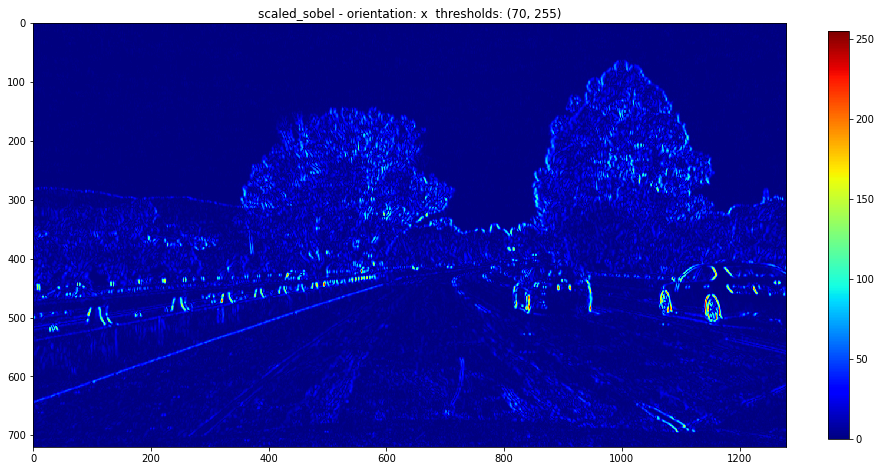

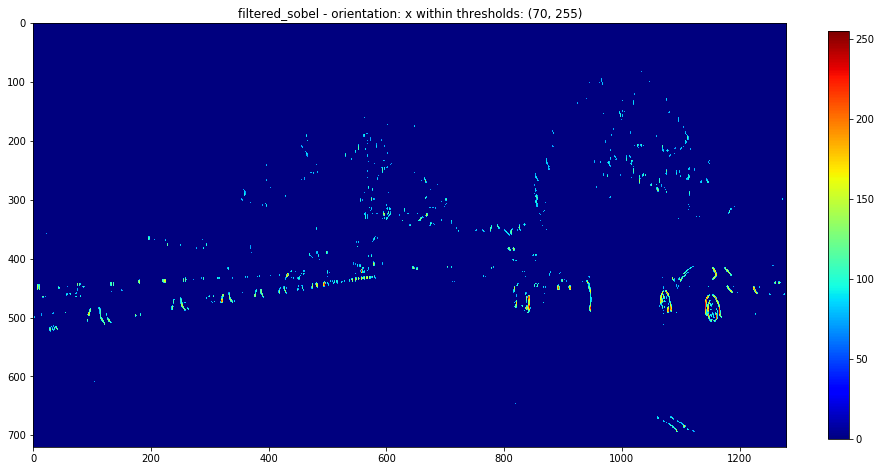

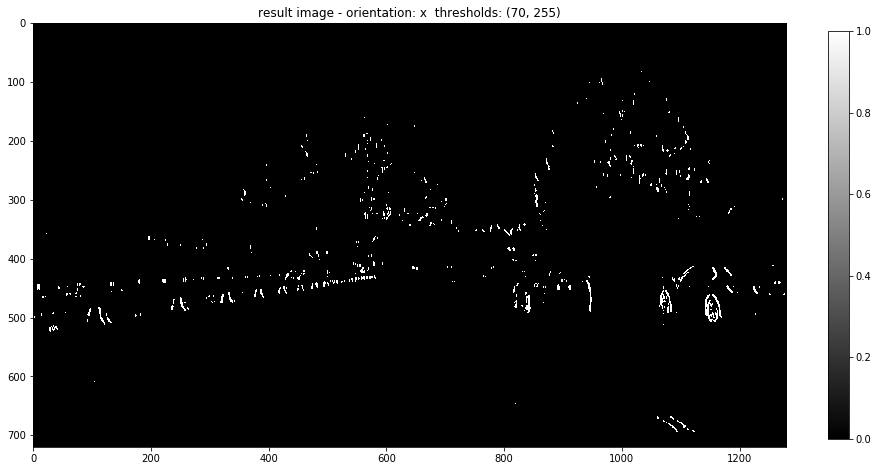

In [43]:
test_ksize = 7
test_x_thr = (70,255)
# Apply each of the thresholding functions
x_binary   = grad_abs_thresh(img_to_process, orient='x', sobel_kernel=test_ksize, thresh=test_x_thr, display = True)

### Gradient Y Thresholding

grad_abs_thresh(): input: (720, 1280, 3)  min:  0  max:  255


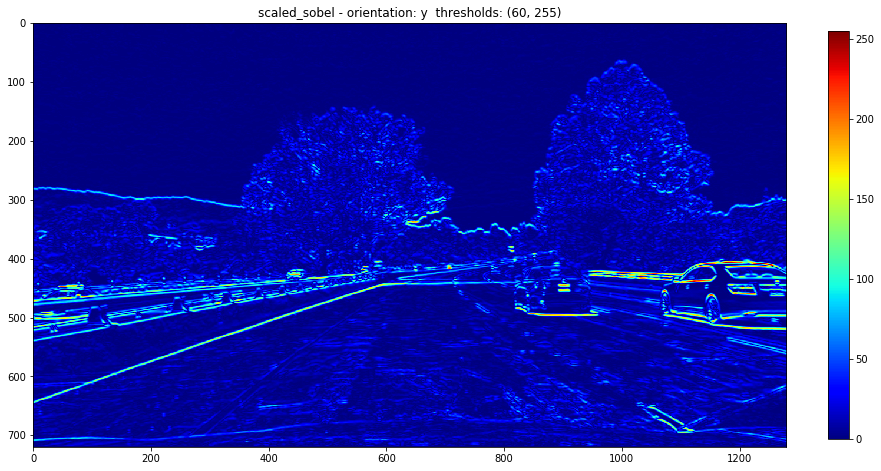

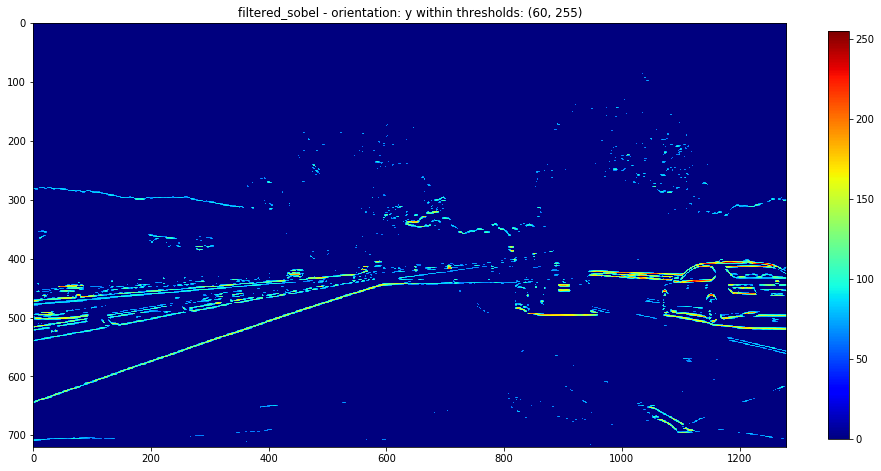

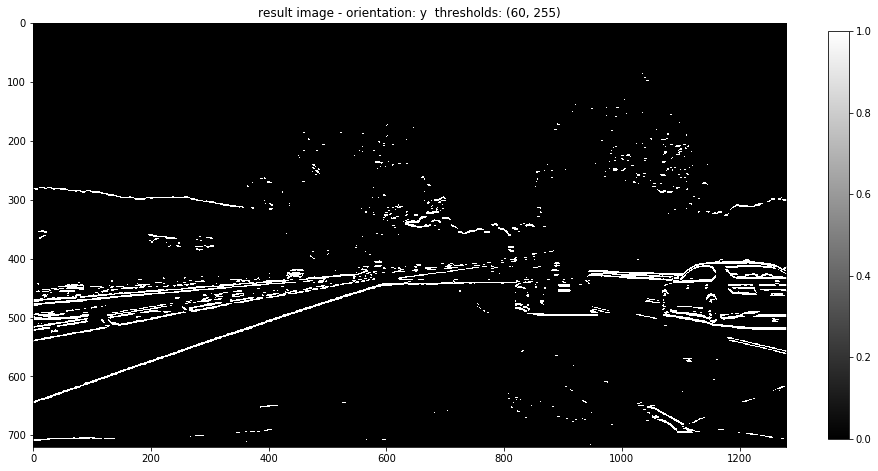

In [44]:
ksize = 7
test_y_thr = (60,255)
# Apply each of the thresholding functions
y_binary   = grad_abs_thresh(img_to_process, orient='y', sobel_kernel=ksize, thresh=test_y_thr, display = True)

### Gradient Directional Thresholding

In [45]:
# img_to_process = imgWarped

grad_dir: (720, 1280)  Deg:  (40, 65) Rad: (0.6981317007977318, 1.1344640137963142)


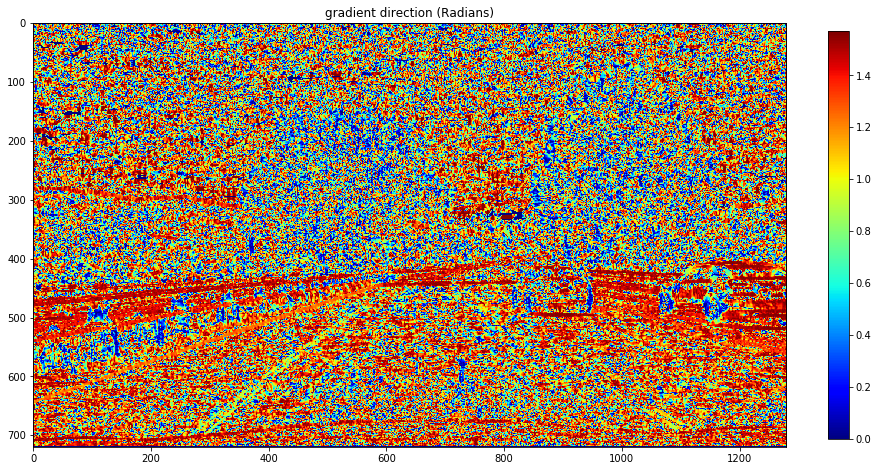

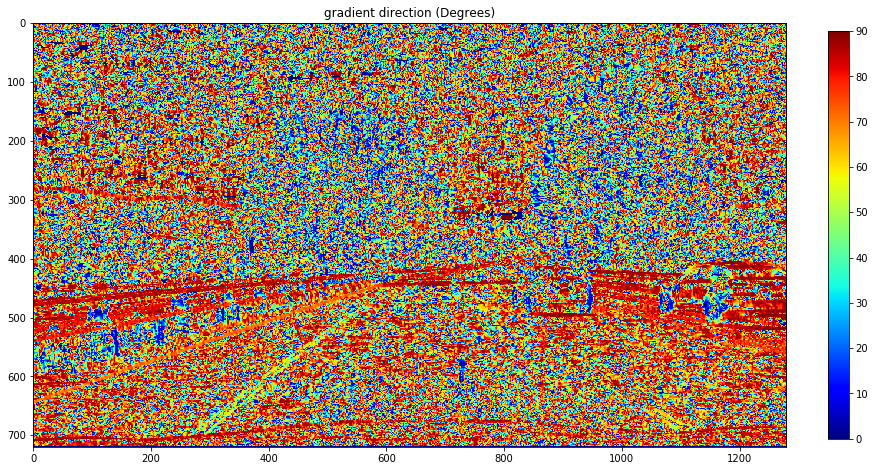

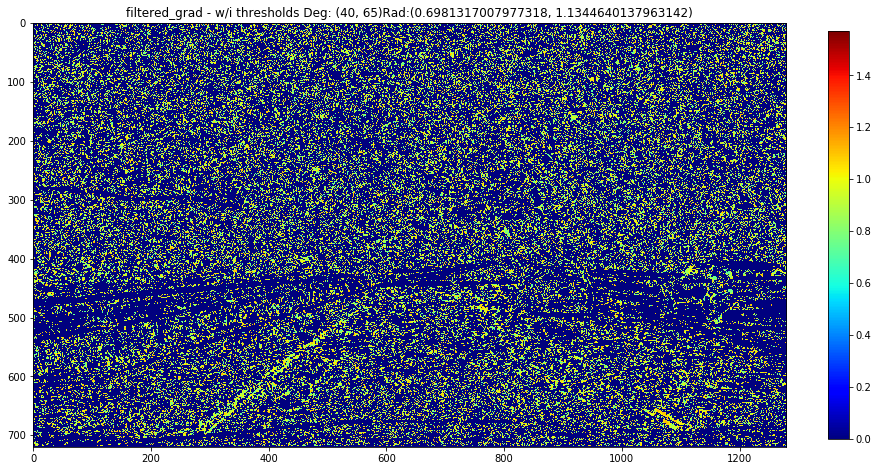

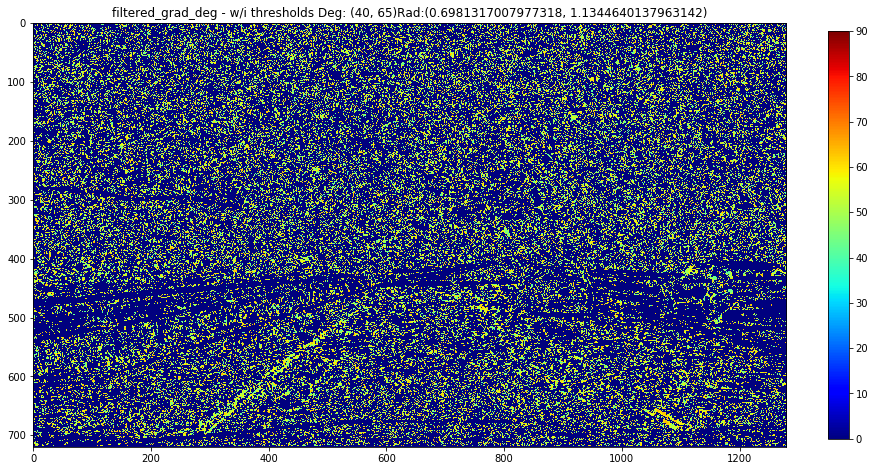

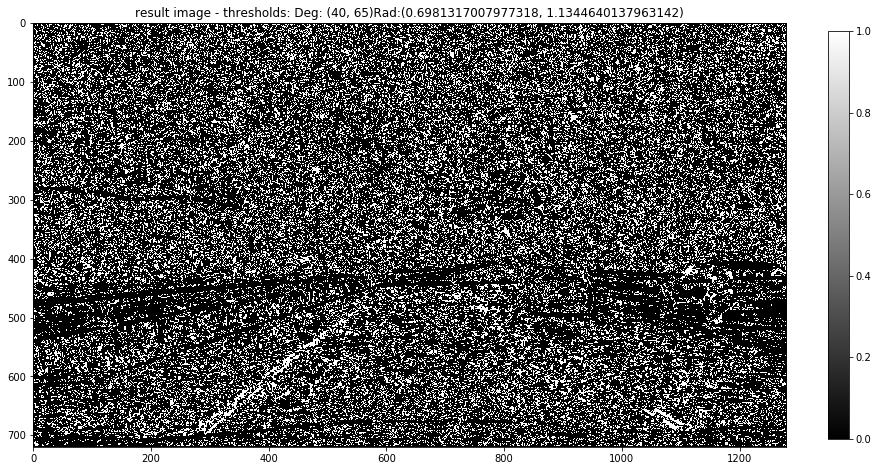

In [47]:
# mag_thr = (90,160)
test_dir_thr = (40,65)
dir_binary = grad_dir_thresh(img_to_process, sobel_kernel=ksize, thresh=test_dir_thr, display = True)

### Gradient Magnitude Thresholding

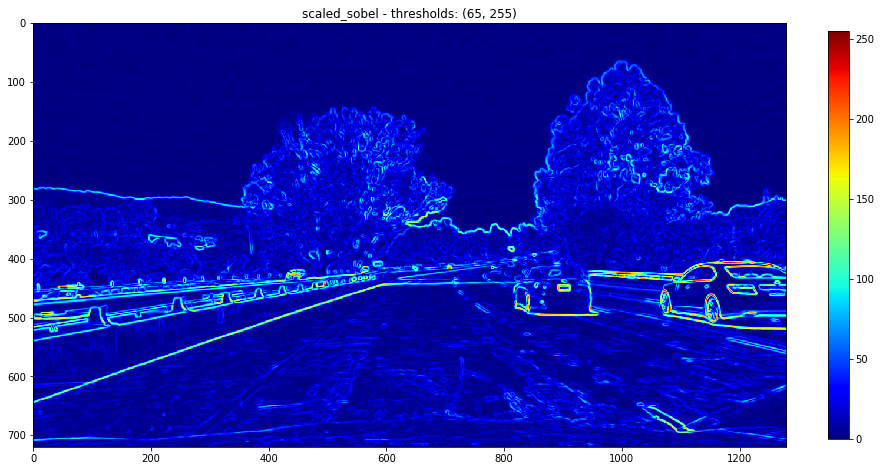

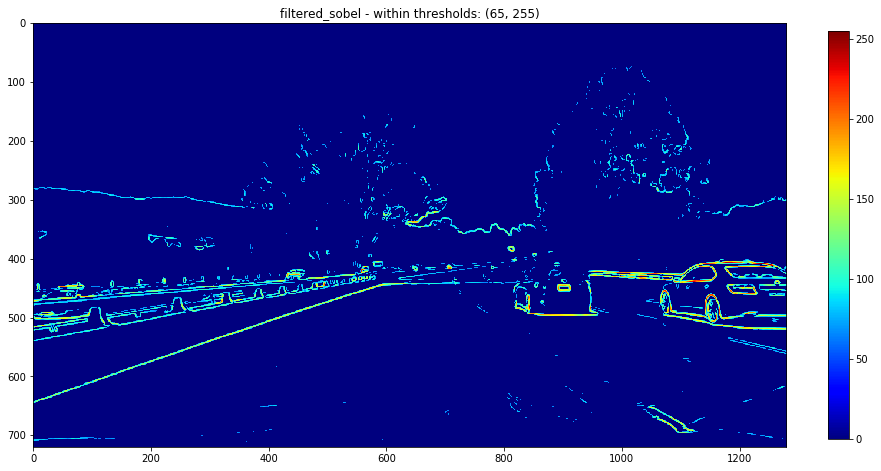

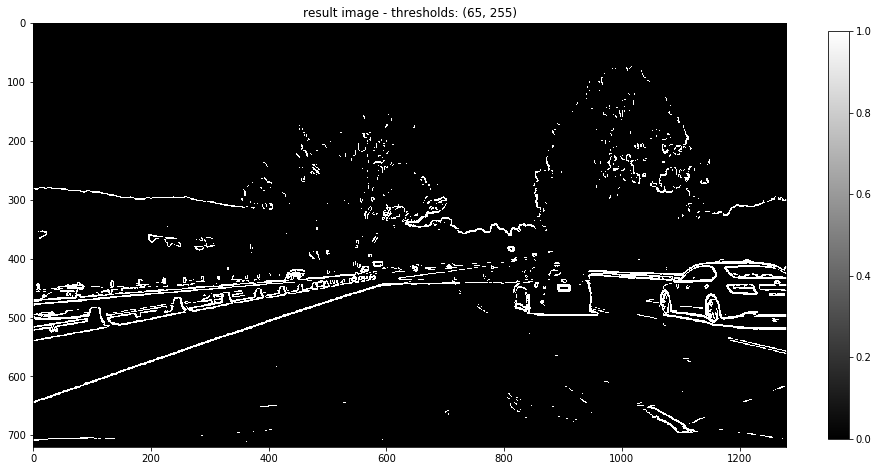

In [48]:
# img_to_process = videoPipeline.imgWarped
# mag_thr = (90,160)
test_mag_thr = (65, 255)
test_ksize   =  7
mag_binary = grad_mag_thresh(img_to_process, sobel_kernel=test_ksize, thresh=test_mag_thr, display = True)


### Gradient Magnitude Thresholding

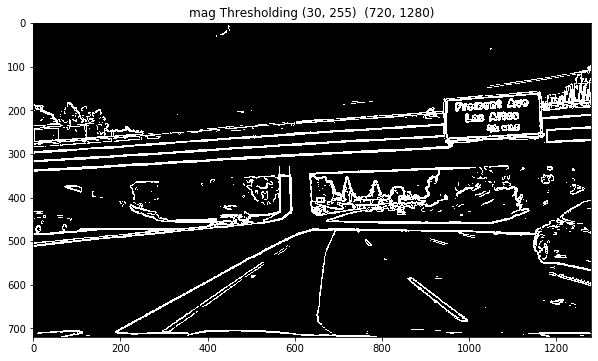

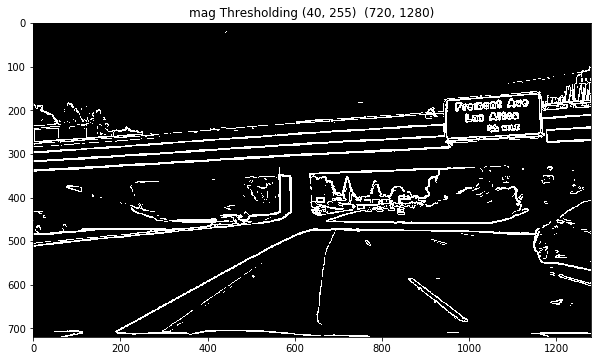

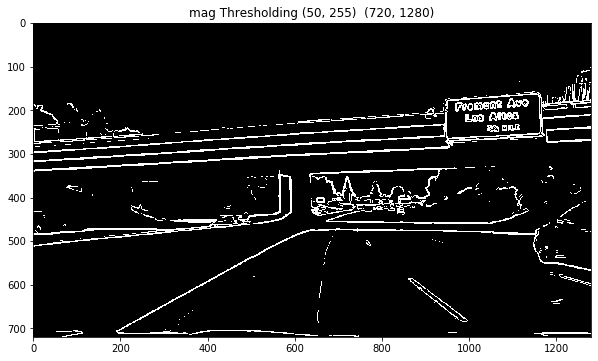

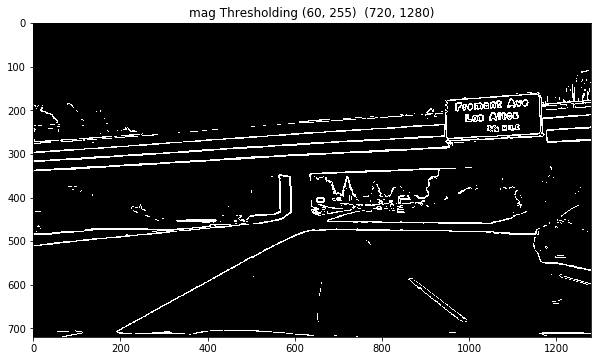

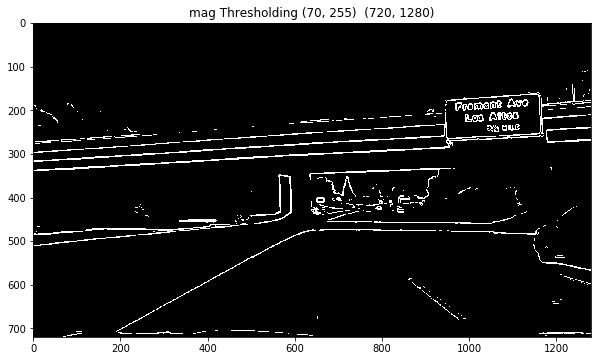

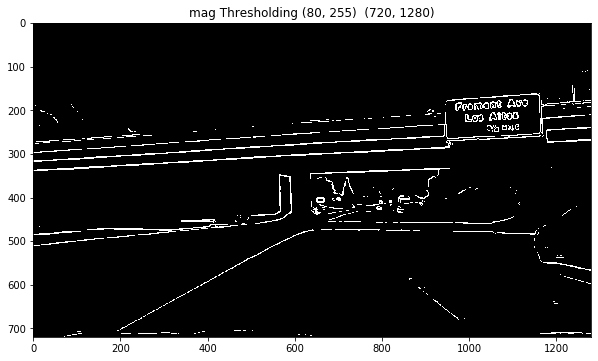

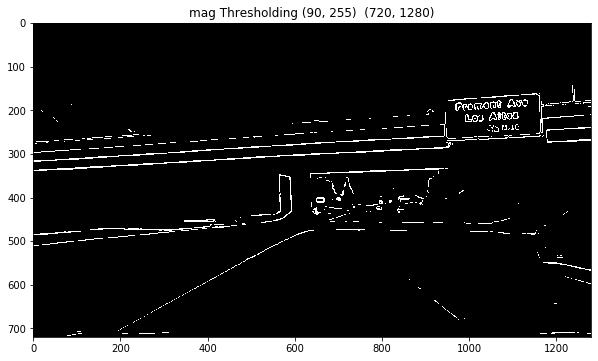

In [39]:
for low_thr in [30, 40, 50, 60,70,80,90]:
    test_mag_thr = (low_thr, 255)
    mag_binary = grad_mag_thresh(imgUndist, sobel_kernel=ksize, thresh=test_mag_thr, display = False)
    display_one(mag_binary, title = 'mag Thresholding '+str(test_mag_thr), size = 10)
#     disp.closePlot()

### Gradient Magnitude  & Direction Thresholding

grad_dir: (720, 1280)  Deg:  (40, 65) Rad: (0.6981317007977318, 1.1344640137963142)


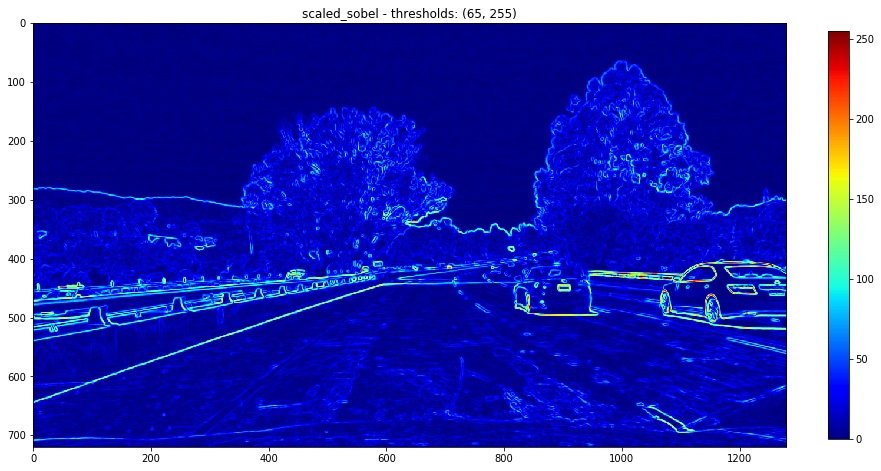

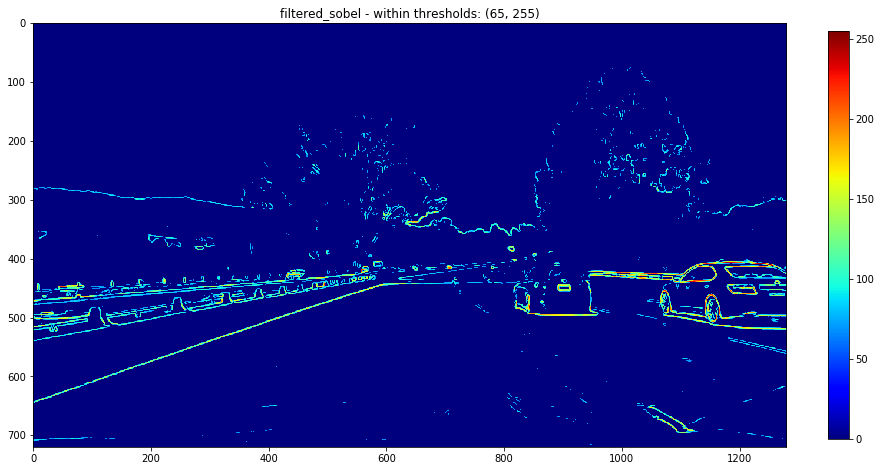

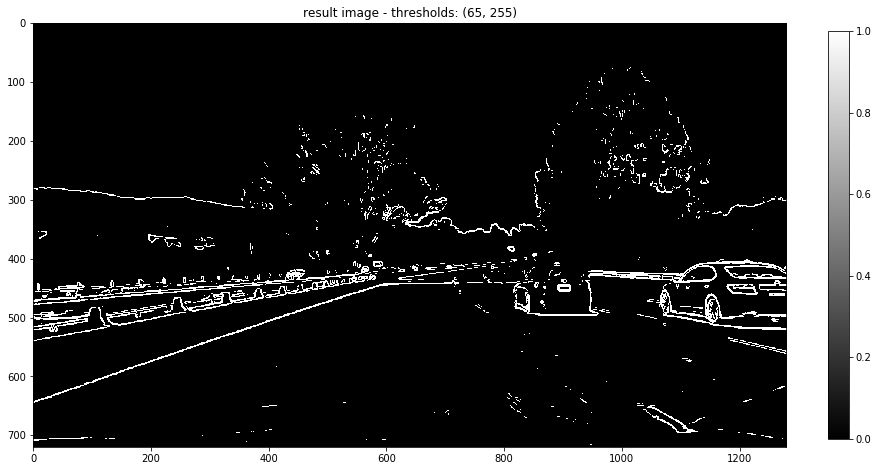

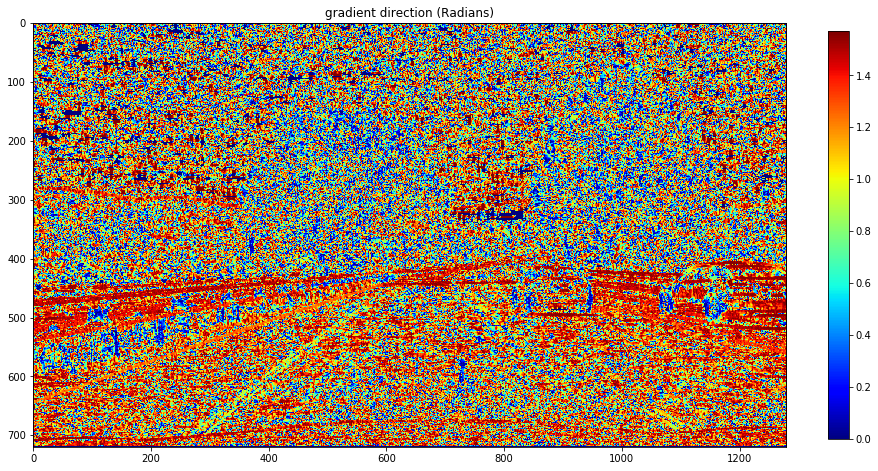

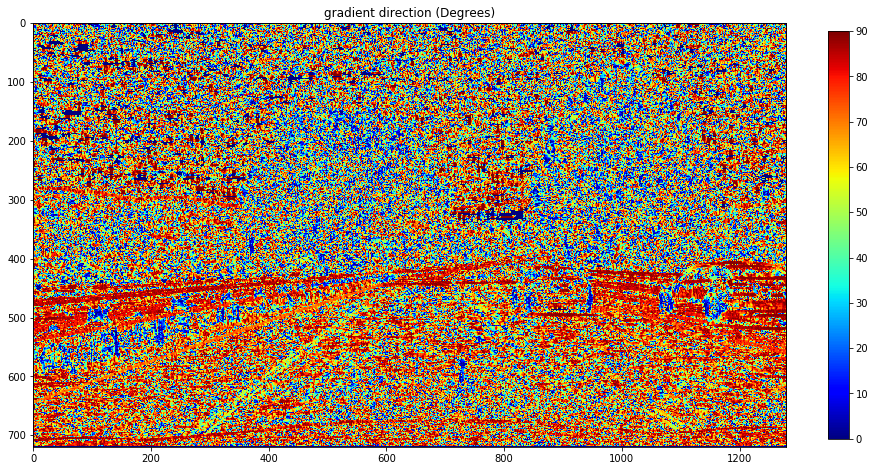

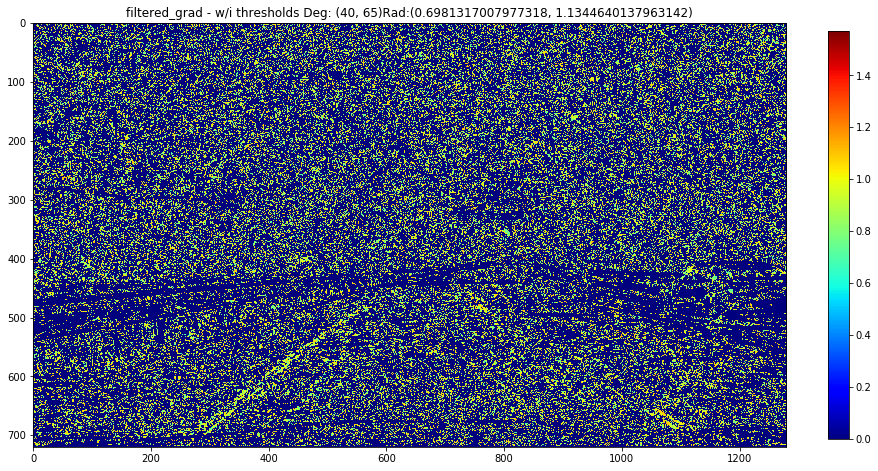

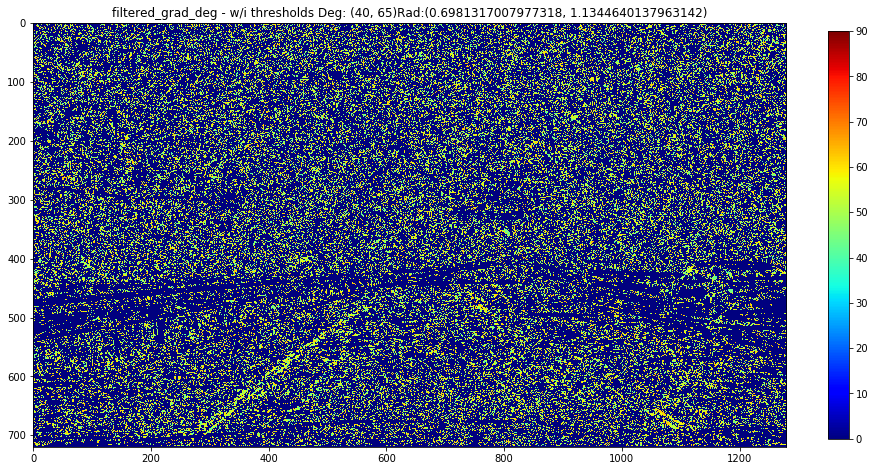

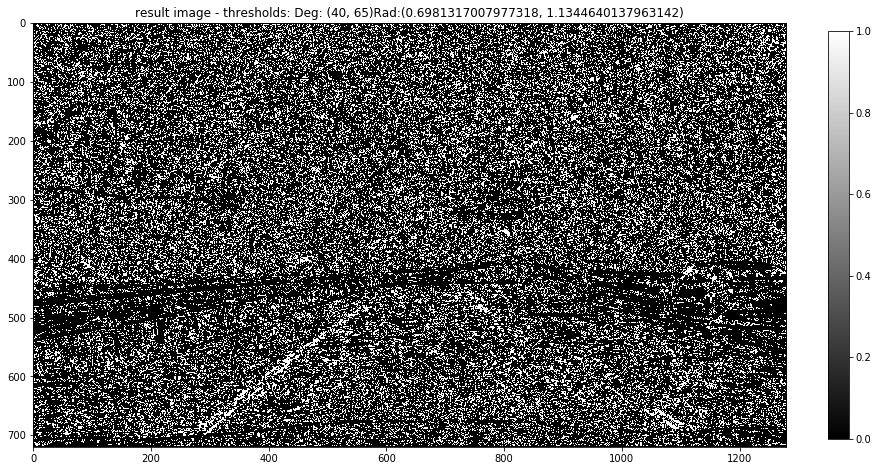

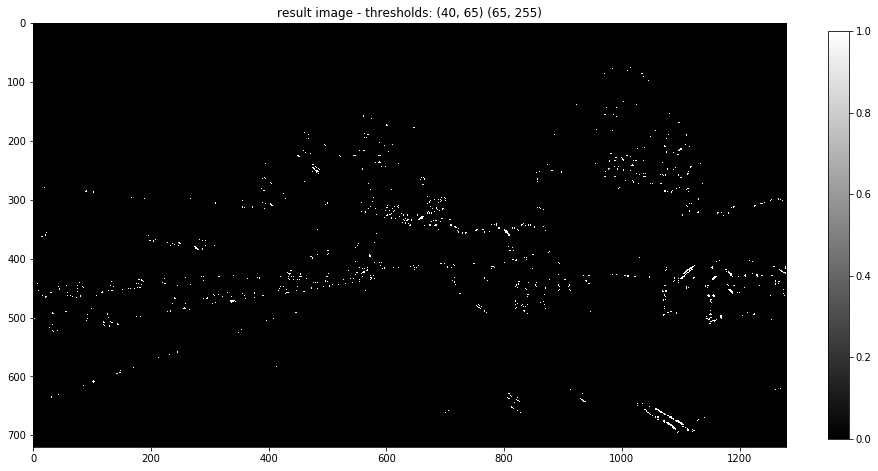

In [52]:
# test_dir_thr = (40,65); test_mag_thr = (35,255)
# img_to_process = videoPipeline.imgWarped
# test_ksize = 7
# test_mag_thr = (5,100); ## Dark
# test_mag_thr = (10,50); ## Light
# test_dir_thr = (0,30)

mag_binary = grad_mag_thresh(img_to_process, sobel_kernel=test_ksize, thresh=test_mag_thr, display = True)
dir_binary = grad_dir_thresh(img_to_process, sobel_kernel=test_ksize, thresh=test_dir_thr, display = True)
cmb_mag_dir  = np.zeros_like(dir_binary)
cmb_mag_dir[ ((mag_binary == 1) & (dir_binary == 1)) ] = 1
display_one_cbar(cmb_mag_dir , title='result image - thresholds: '+str(test_dir_thr)+' '+str(test_mag_thr))

### Saturation Thresholding 

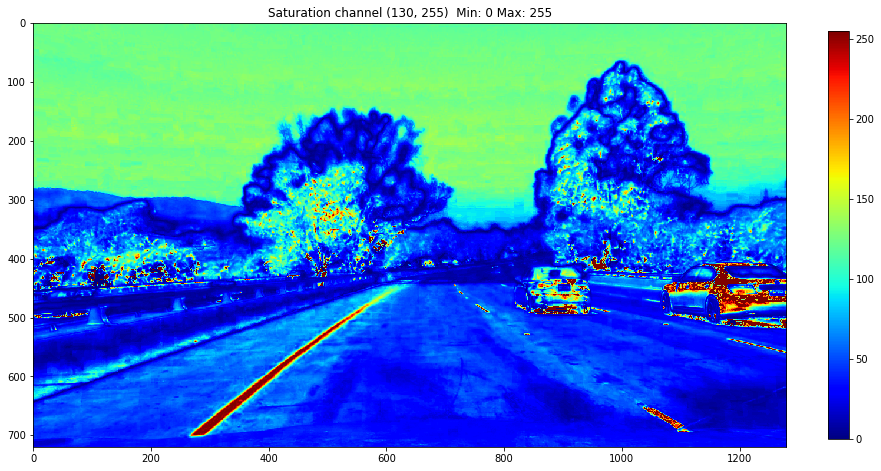

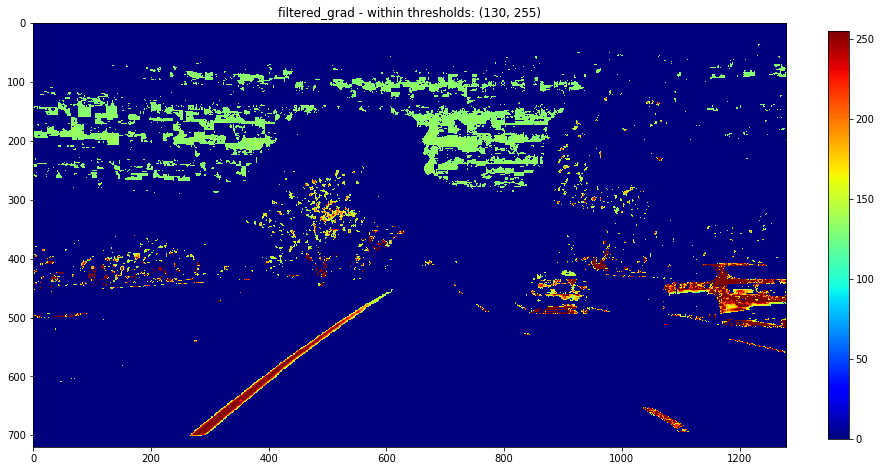

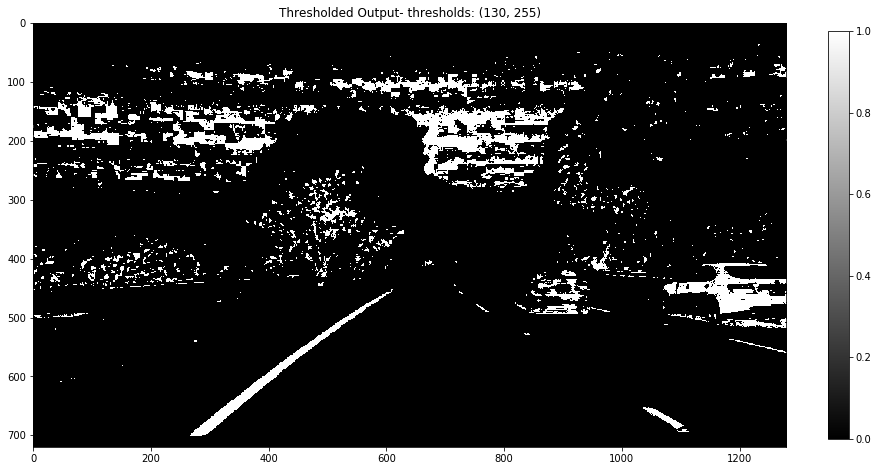

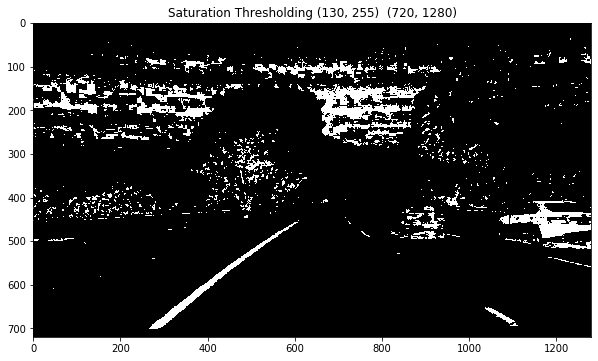

In [56]:
# img_to_process = videoPipeline.imgWarped
test_sat_thr = (130, 255)
s_binary   = saturation_thresh(img_to_process, thresh=test_sat_thr, display = True)
display_one(s_binary, title = 'Saturation Thresholding '+str(test_sat_thr), size = 10)    

### Saturation Thresholding 

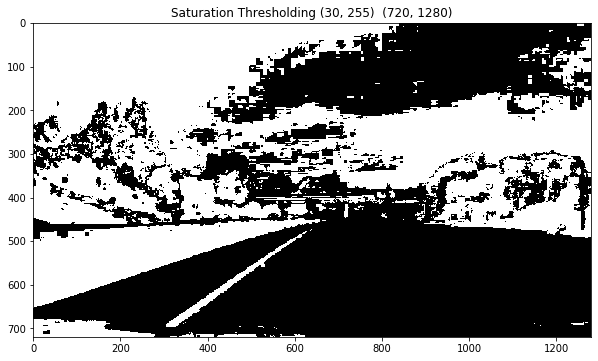

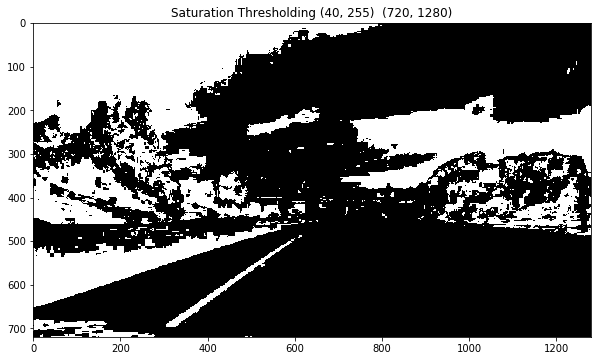

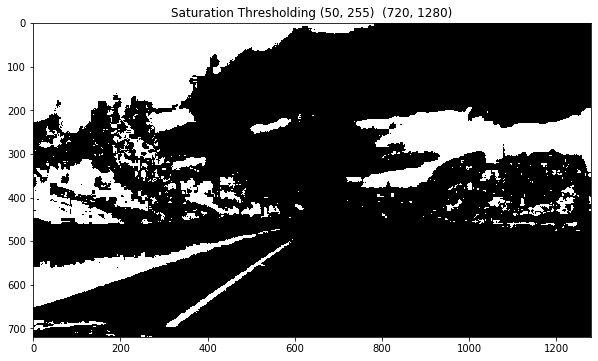

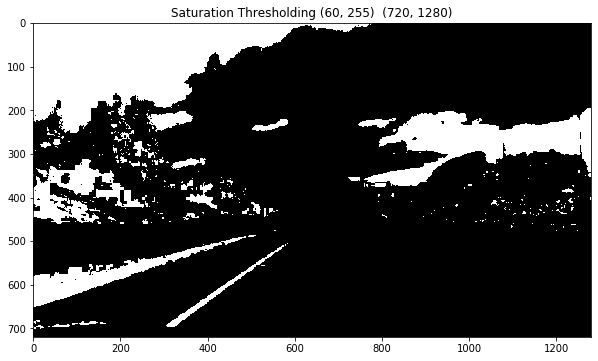

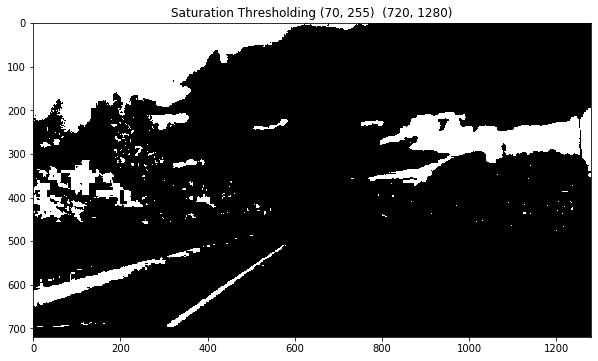

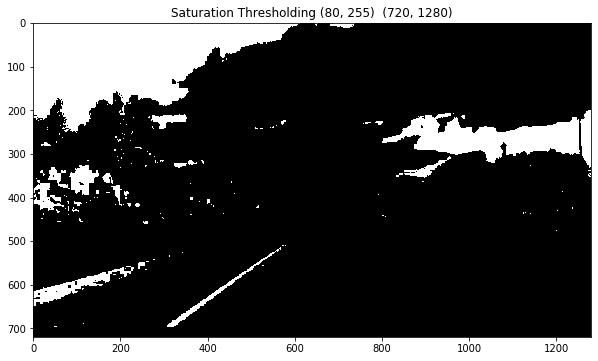

In [142]:
for low_thr in [30, 40, 50, 60, 70, 80]:
    sat_thr = (low_thr, 255)
    s_binary   = saturation_thresh(image, thresh=sat_thr)
    display_one(s_binary, title = 'Saturation Thresholding '+str(sat_thr), size = 10)    

### Saturation Thresholding 

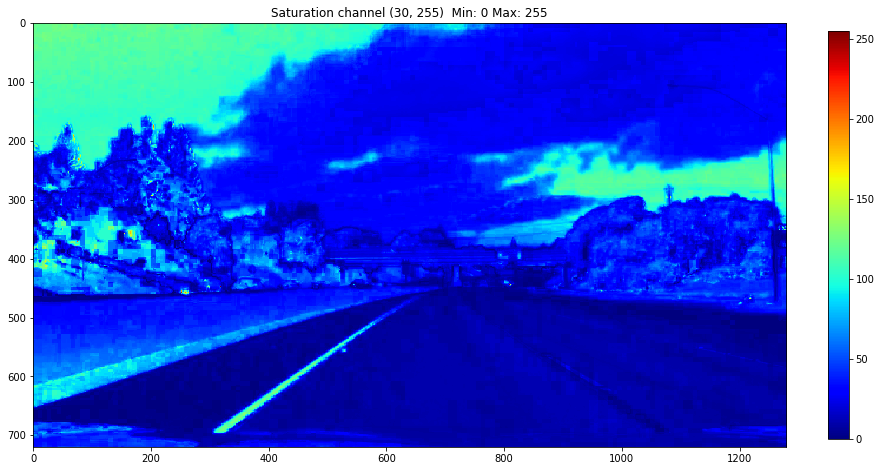

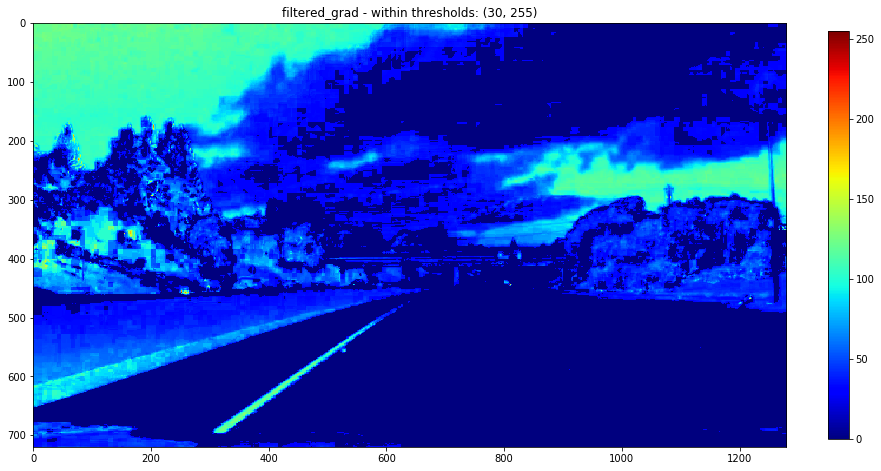

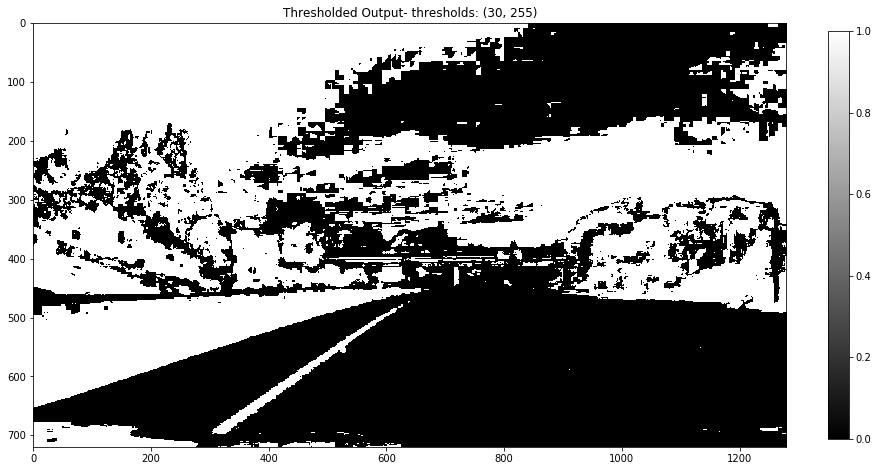

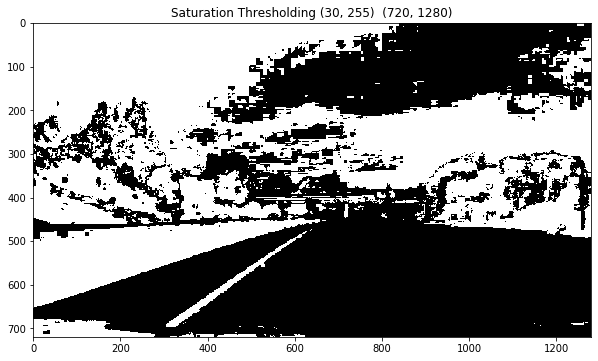

In [141]:
sat_thr = (30, 255)
s_binary   = saturation_thresh(image, thresh=sat_thr, display = True)
display_one(s_binary, title = 'Saturation Thresholding '+str(sat_thr), size = 10)    

### Hue Thresholding 

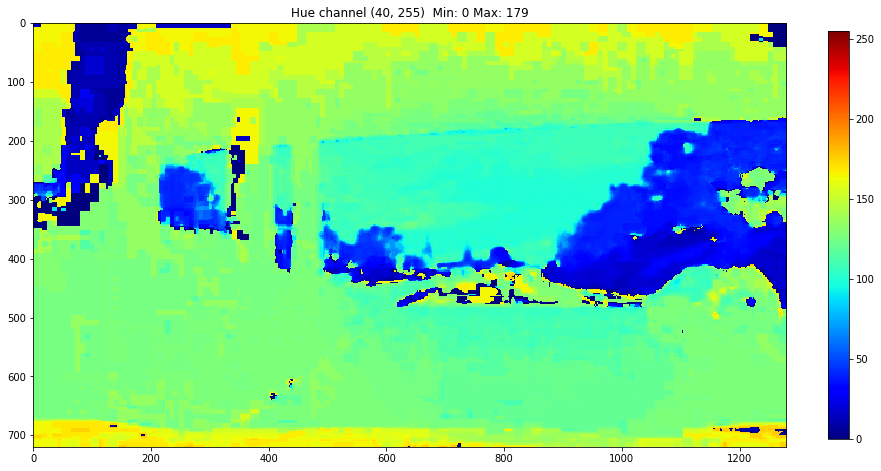

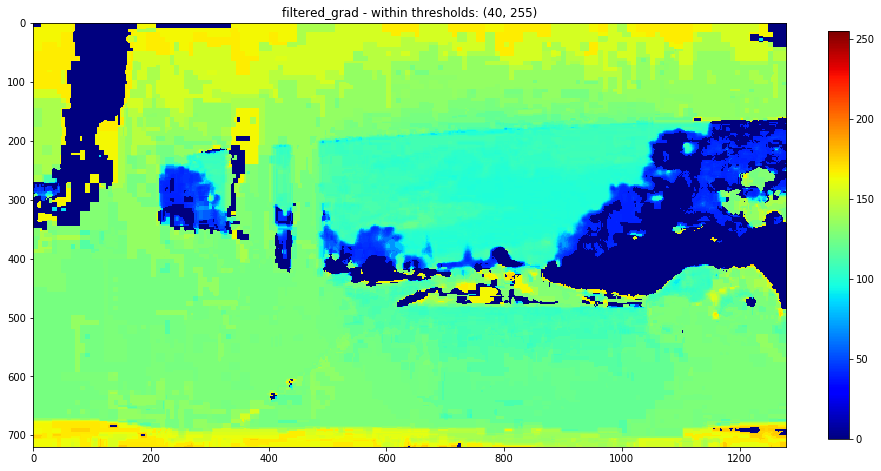

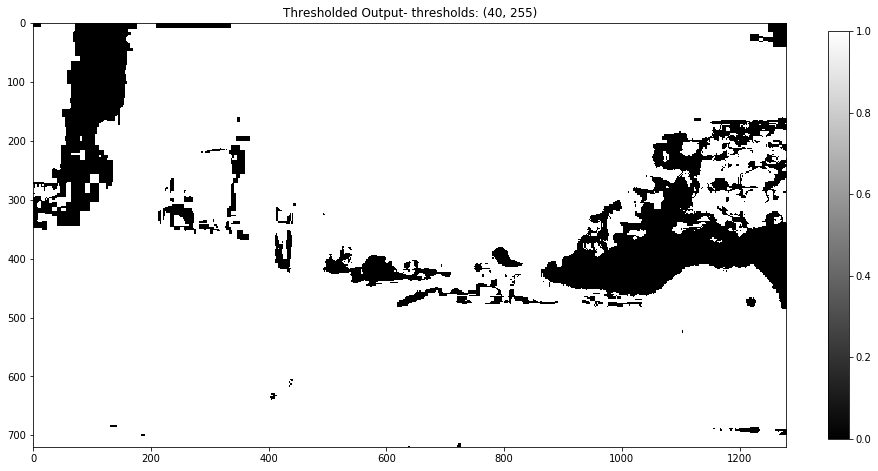

In [178]:
test_hue_thr = (40, 255)
s_binary   = hue_thresh(image, thresh=test_hue_thr, display = True)
# display_one(s_binary, title = 'Hue Thresholding '+str(test_hue_thr), size = 10)    

### Level Thresholding 

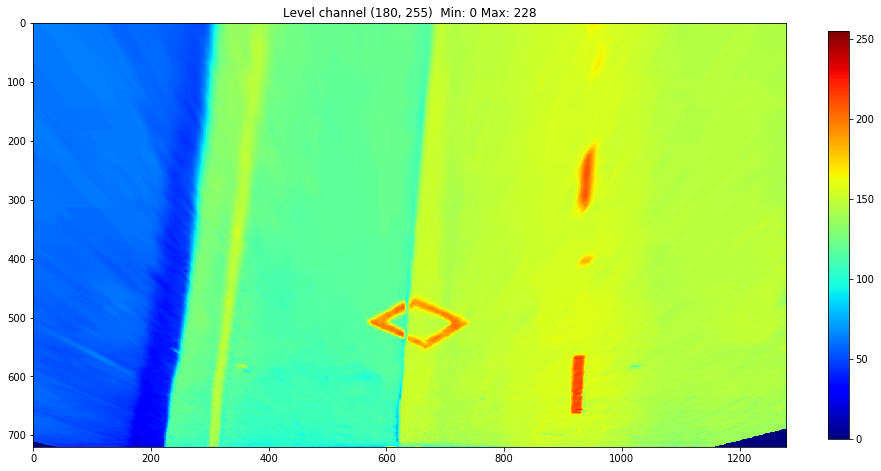

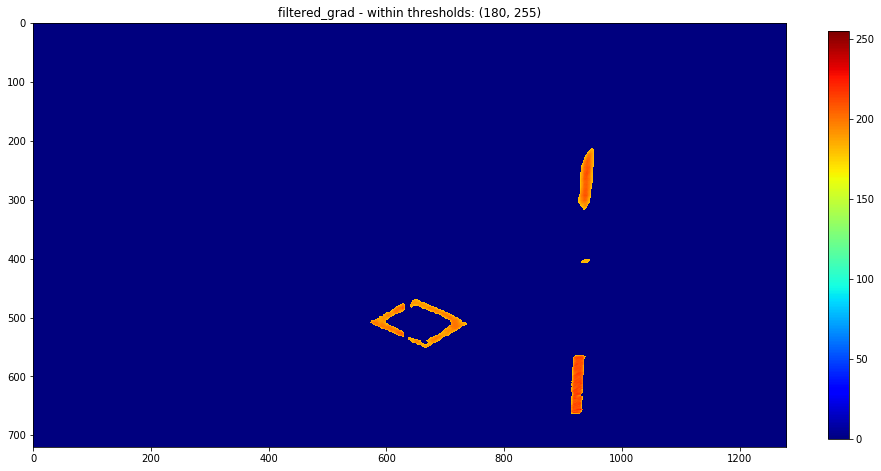

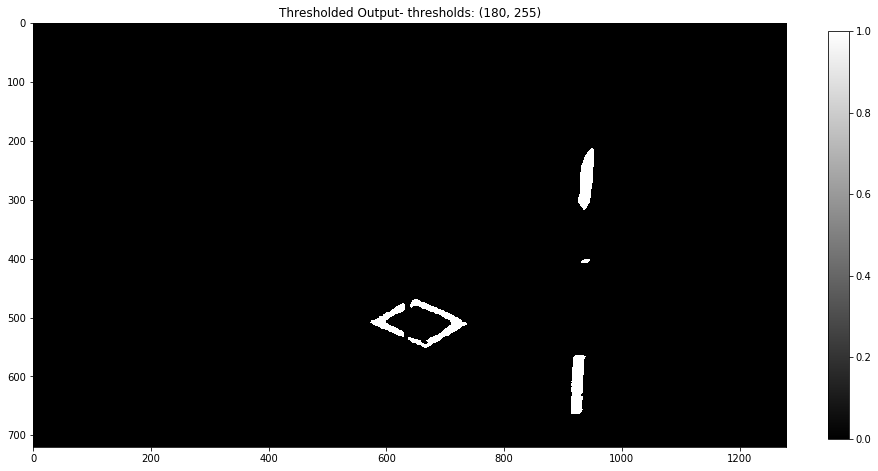

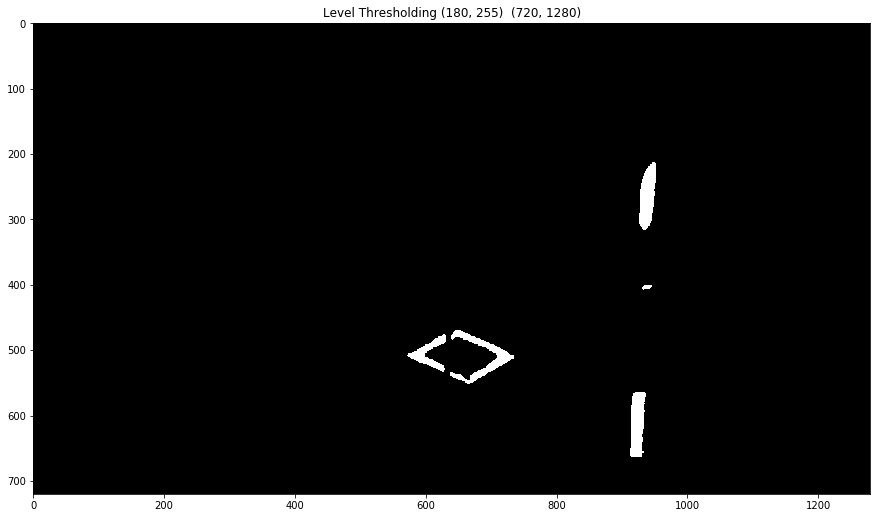

In [38]:
img_to_process = videoPipeline.imgWarped
test_lvl_thr = (180, 255)
s_binary   = level_thresh(img_to_process, thresh=test_lvl_thr, display = True)
display_one(s_binary, title = 'Level Thresholding '+str(test_lvl_thr))    

### HSV Value Thresholding 

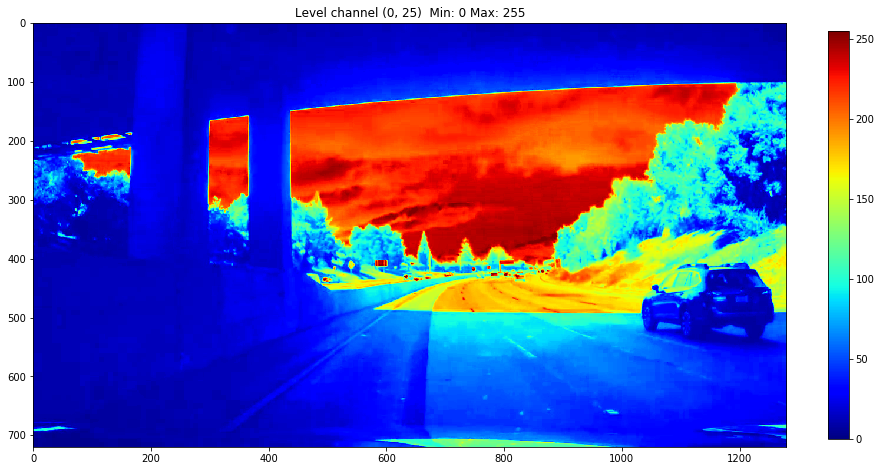

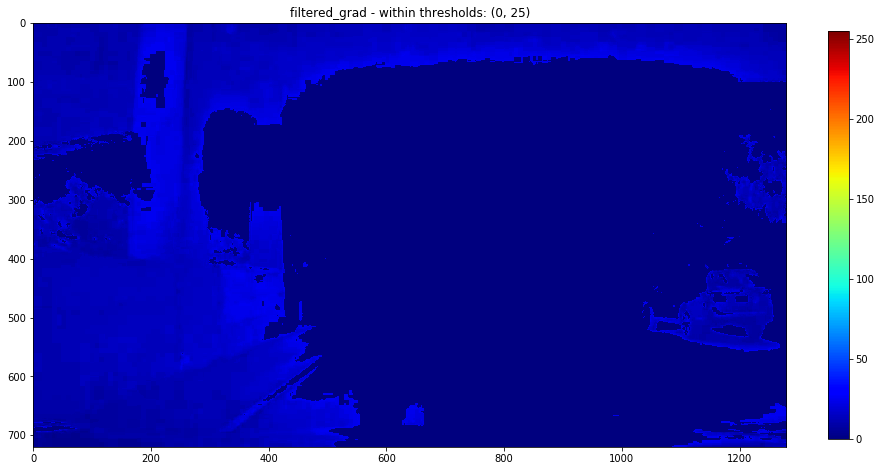

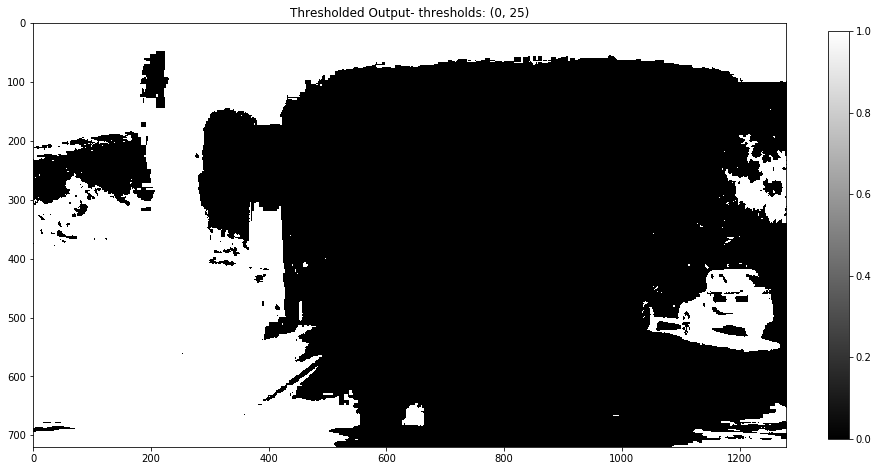

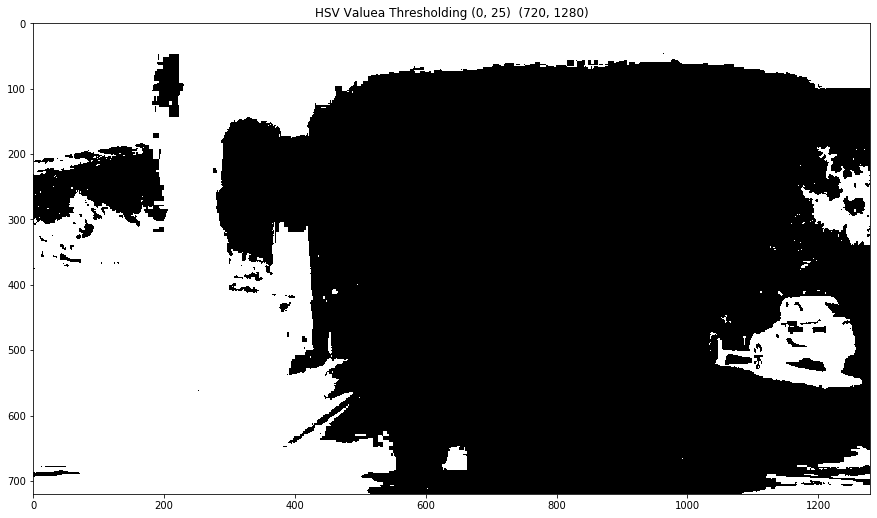

In [205]:
test_val_thr = (0, 25)
s_binary   = HSV_value_thresh(image, thresh=test_val_thr, display = True)
display_one(s_binary, title = 'HSV Valuea Thresholding '+str(test_val_thr))    

### YCrCb Y Thresholding 

In [207]:
from common.sobel import *

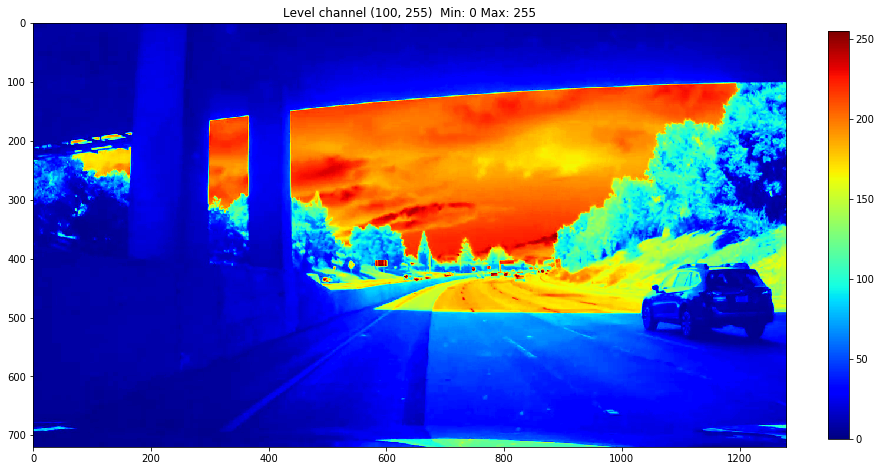

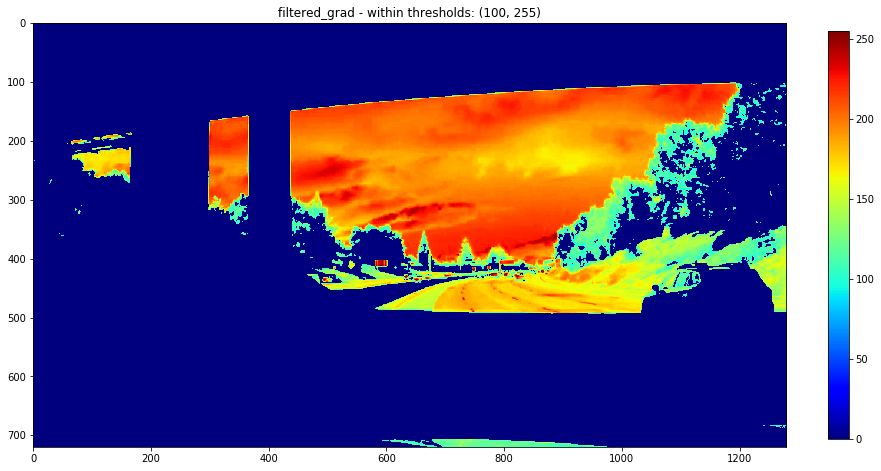

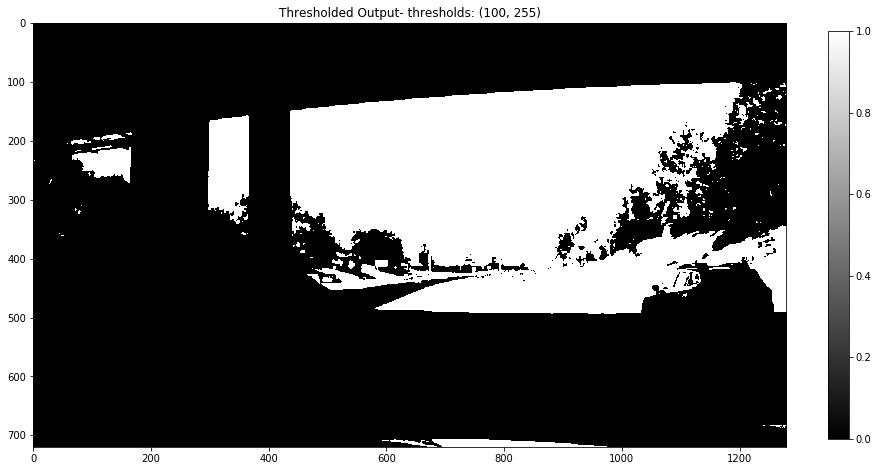

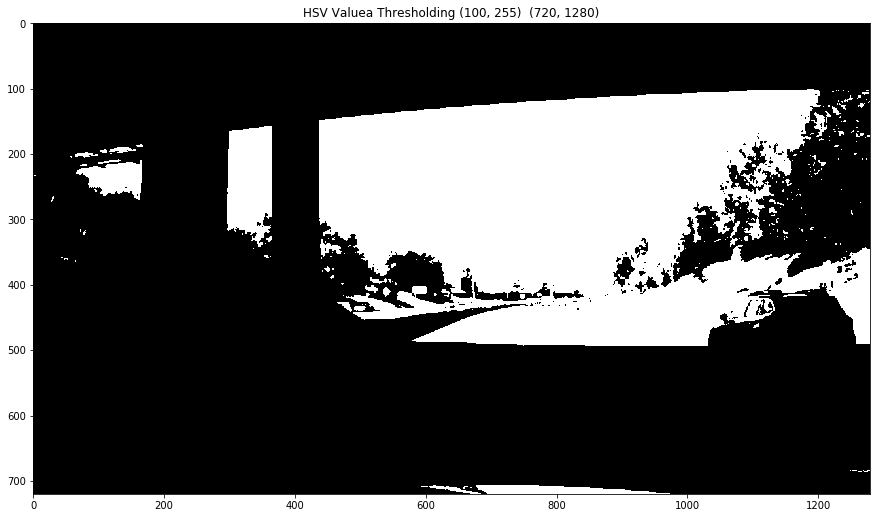

In [208]:
test_Y_thr = (100, 255)
s_binary   = YCrCb_Y_thresh(image, thresh=test_Y_thr, display = True)
display_one(s_binary, title = 'HSV Valuea Thresholding '+str(test_Y_thr))    

### YCrCb Cr Thresholding 

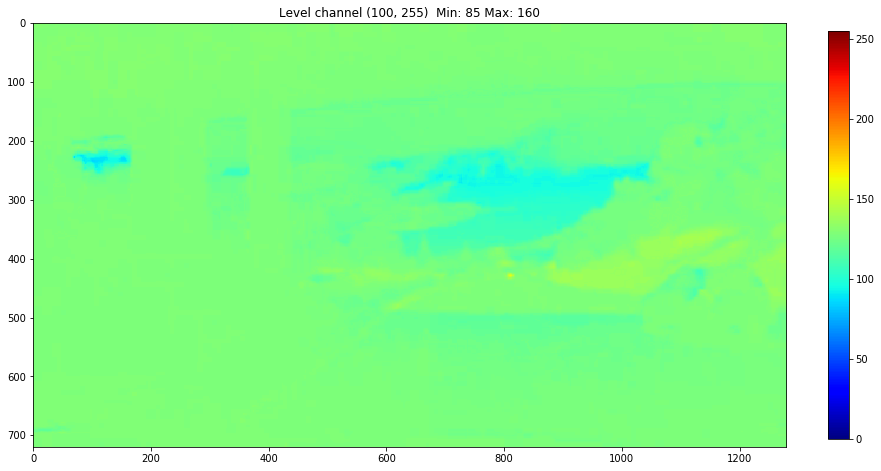

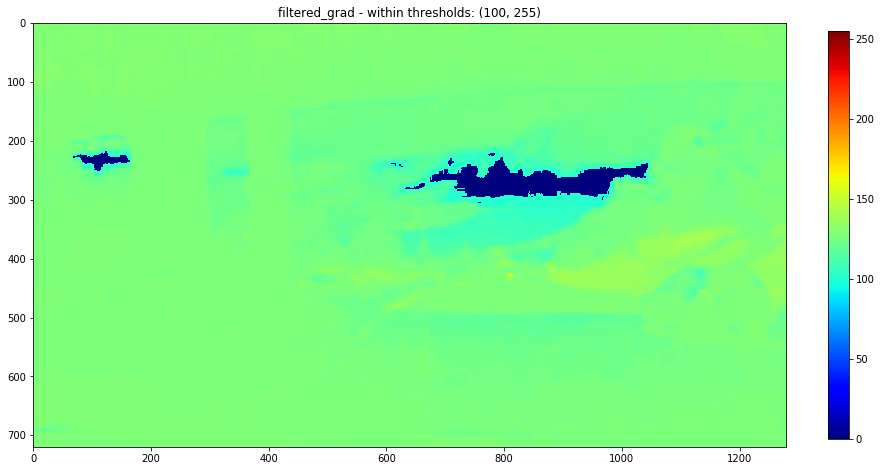

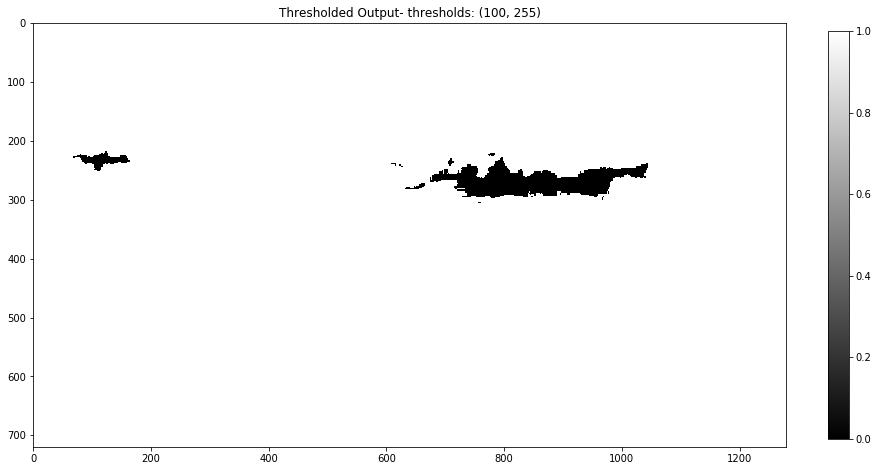

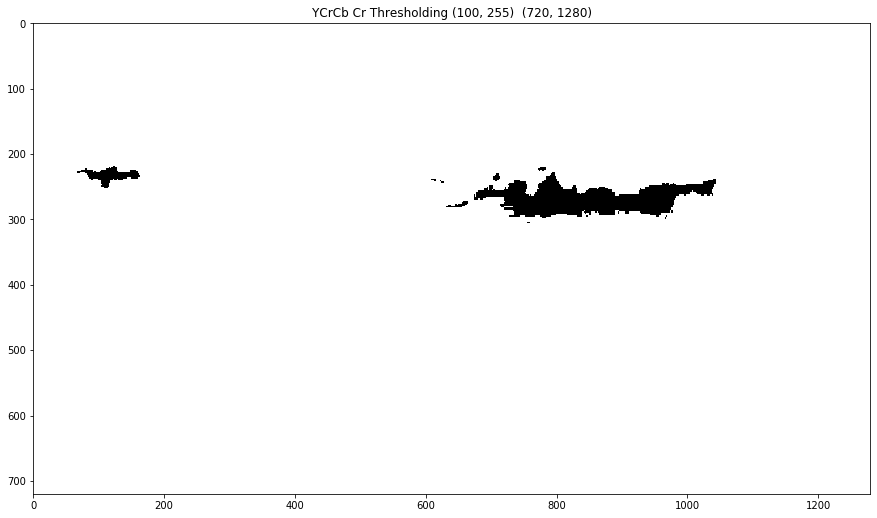

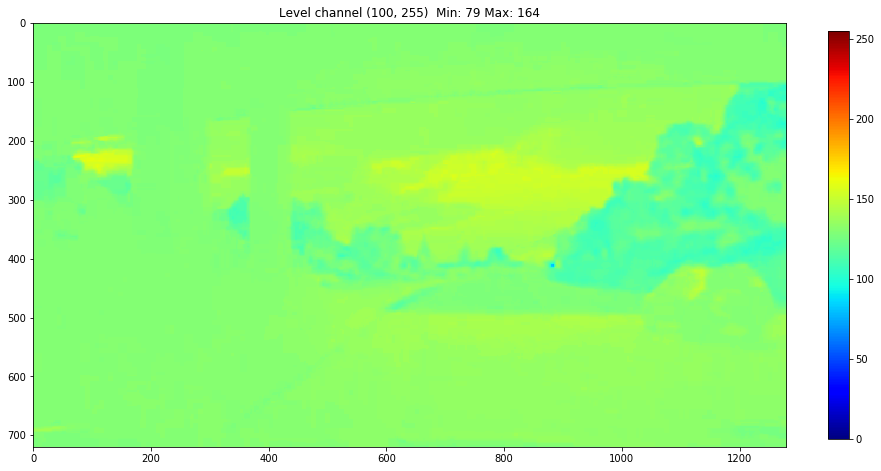

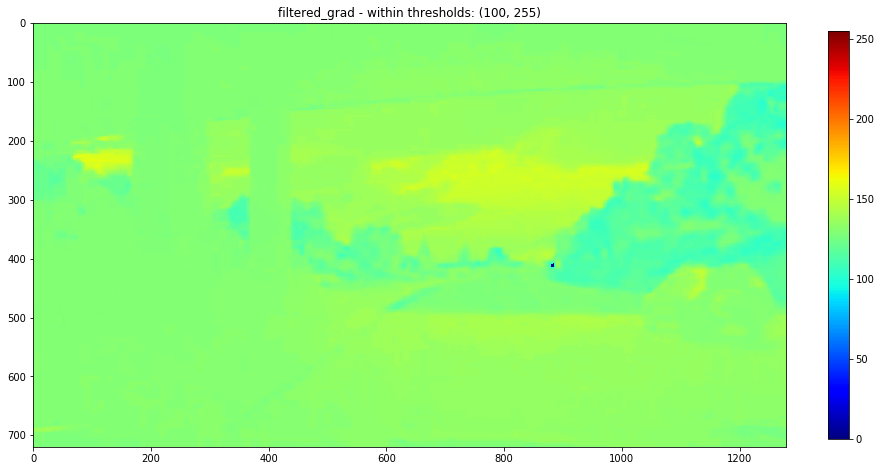

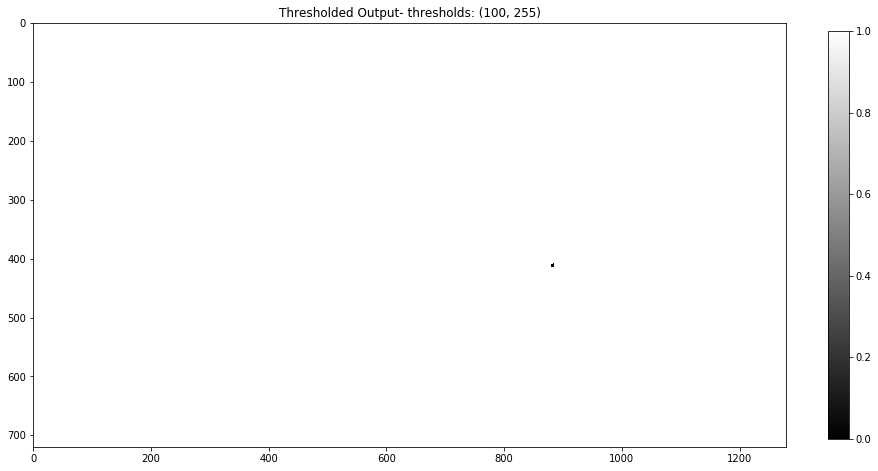

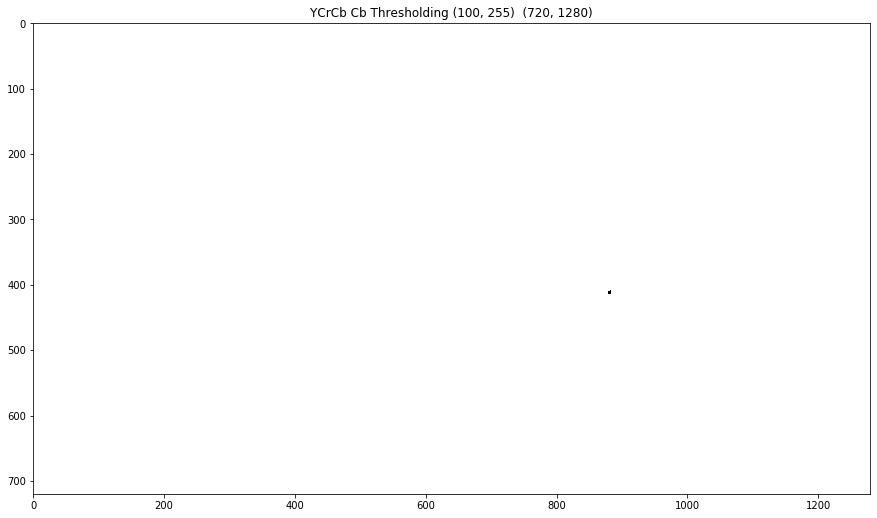

In [210]:
test_Cr_thr = (100, 255)
s_binary   = YCrCb_Cr_thresh(image, thresh=test_Cr_thr, display = True)
display_one(s_binary, title = 'YCrCb Cr Thresholding '+str(test_Cr_thr)) 

test_Cb_thr = (100, 255)
s_binary   = YCrCb_Cb_thresh(image, thresh=test_Cb_thr, display = True)
display_one(s_binary, title = 'YCrCb Cb Thresholding '+str(test_Cb_thr)) 

### Red Channel  Thresholding 

 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)


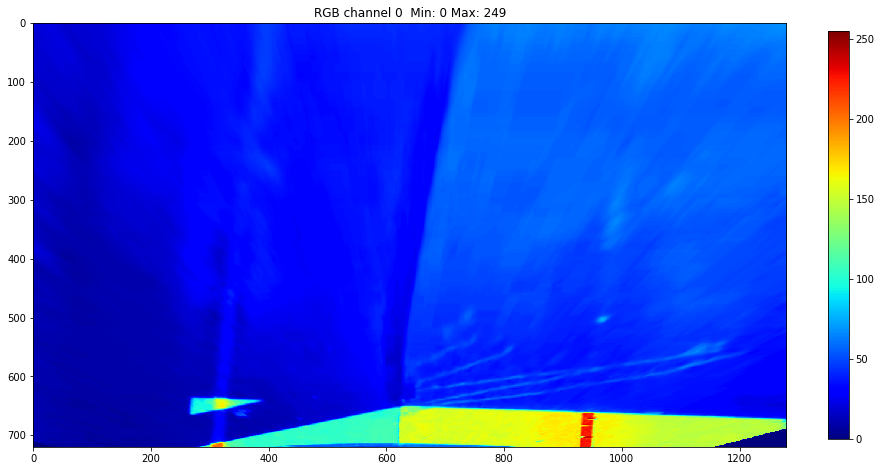

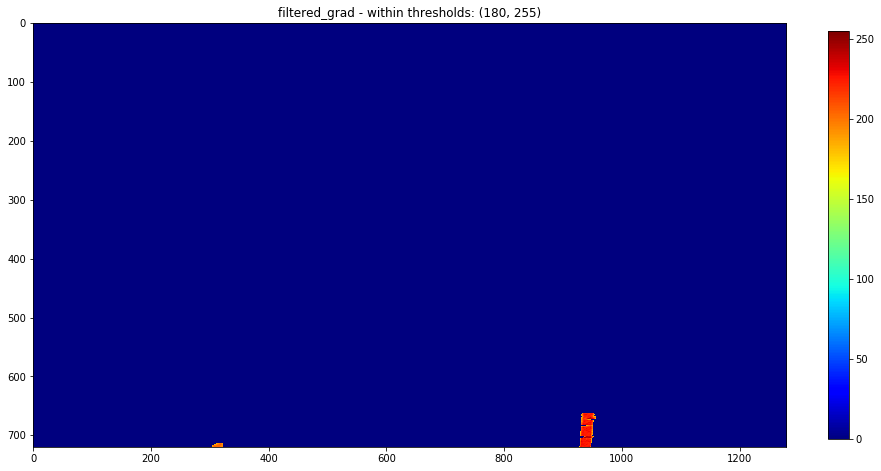

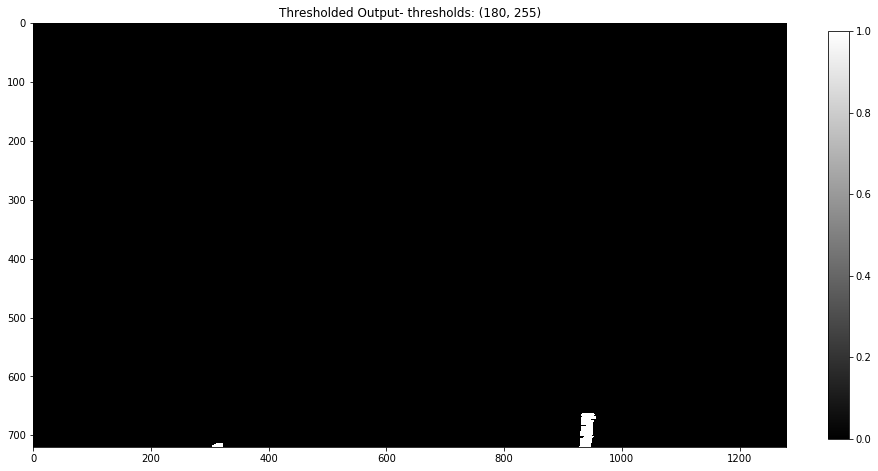

In [267]:
# from common.sobel import *
img_to_process = videoPipeline.imgWarped
test_rgb_thr  = (180, 255)
red_binary = color_thresh(img_to_process, thresh=test_rgb_thr, channel = 0, display = True)
# display_one_cbar(s_binary, title = 'Red Channel Thresholding '+str(rgb_thr) )    

### Green Channel  Thresholding 

 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)


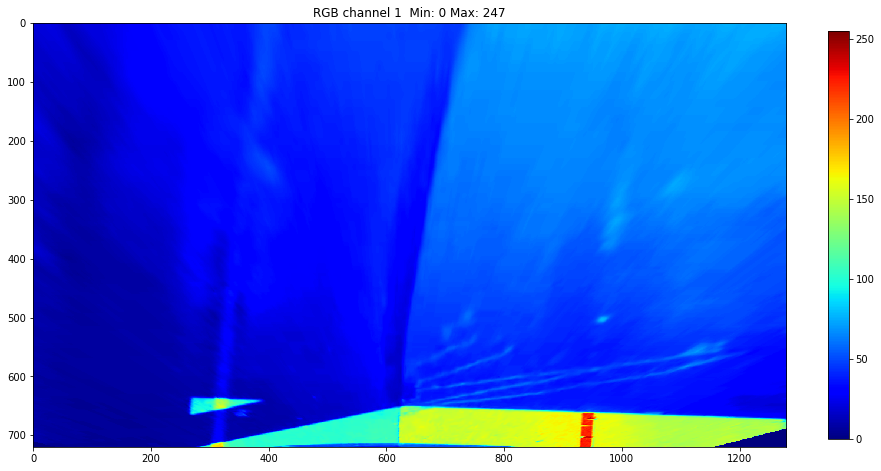

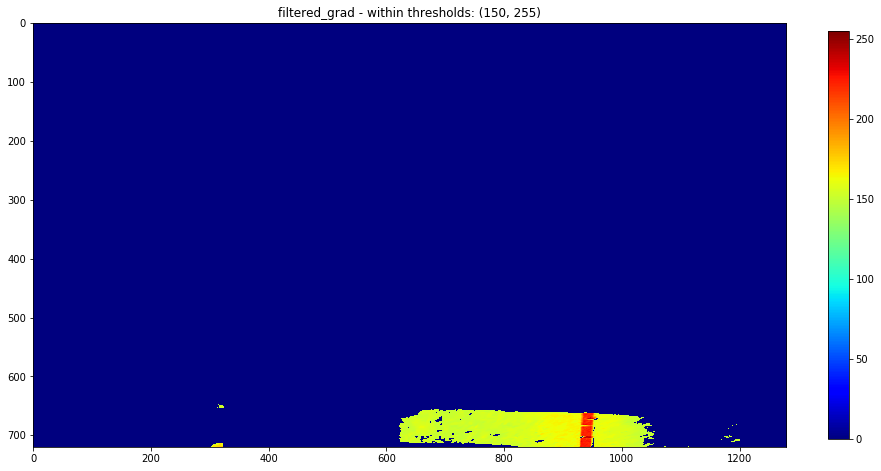

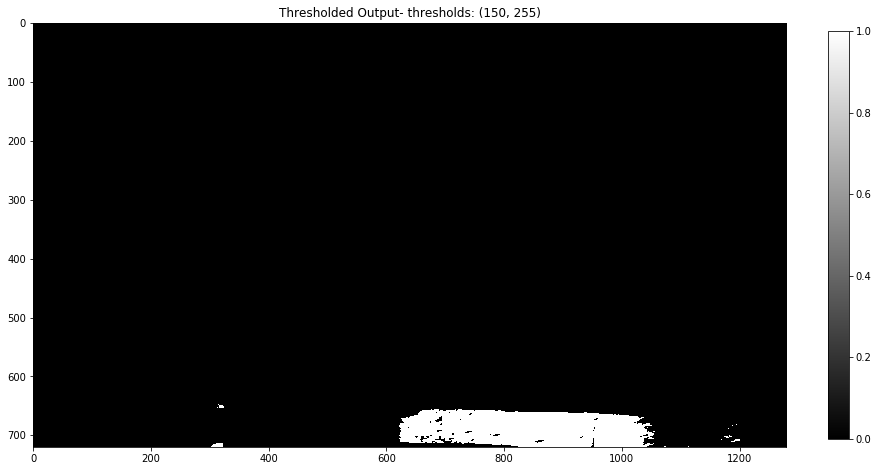

In [269]:
# from common.sobel import *
img_to_process = videoPipeline.imgWarped
test_rgb_thr = (180, 255)
green_binary   = color_thresh(img_to_process, thresh=test_rgb_thr, channel = 1, display = True)
# display_one_cbar(s_binary, title = 'Green Channel Thresholding '+str(rgb_thr) )    

### Blue Channel  Thresholding 

 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)


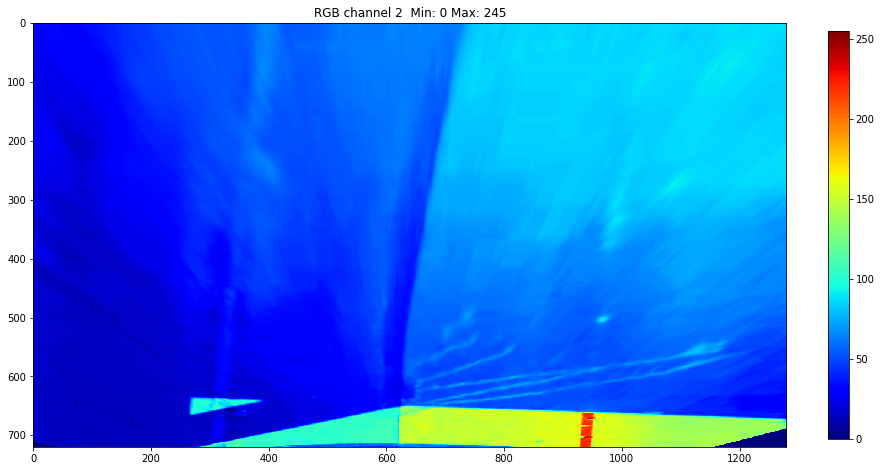

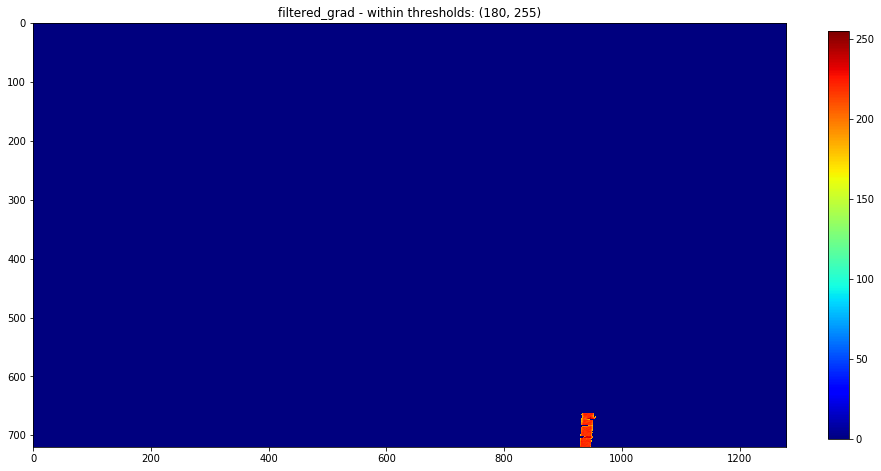

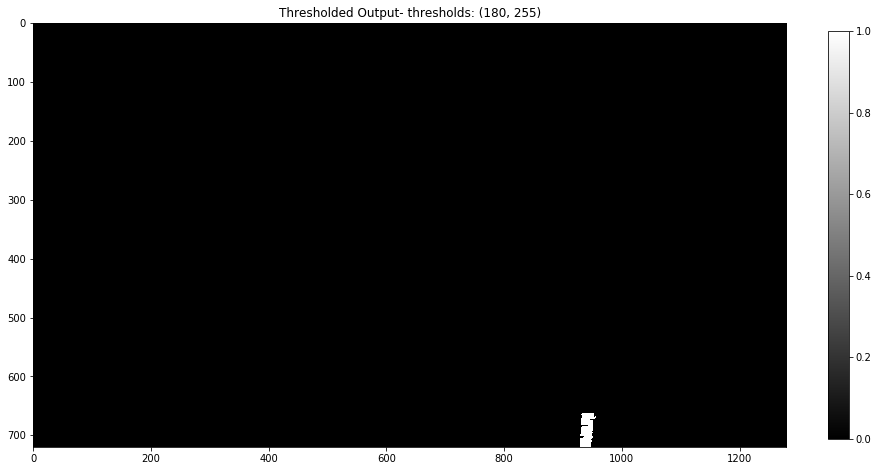

In [270]:
from common.sobel import *
img_to_process = videoPipeline.imgWarped
test_rgb_thr = (180, 255)
blue_binary   = color_thresh(img_to_process, thresh=test_rgb_thr, channel = 2, display = True)
# display_one_cbar(s_binary, title = 'BLUE Channel Thresholding '+str(rgb_thr) )    

In [58]:
from common.sobel import *

### RGB Thresholding

In [39]:
cmb_rgb_dir  = np.zeros_like(dir_binary)
cmb_rgb_dir[ (red_binary == 1) | (green_binary == 1)| (blue_binary ==1) ] = 1
display_one_cbar(cmb_rgb_dir , title='result image - thresholds: '+str(test_rgb_thr)+' '+str(test_rgb_thr))

rgb_or_output = RGB_thresh(img_to_process, thresh=test_rgb_thr, display = True)

NameError: name 'dir_binary' is not defined

### RGB Thresholding

 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)
 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)
 filtered_dir :  (720, 1280)
 s_channel    :  (720, 1280)
 binary_output:  (720, 1280)
 filtered_dir :  (720, 1280, 3)
 s_channel    :  (720, 1280, 3)
 binary_output:  (720, 1280)
(720, 1280) 0 1


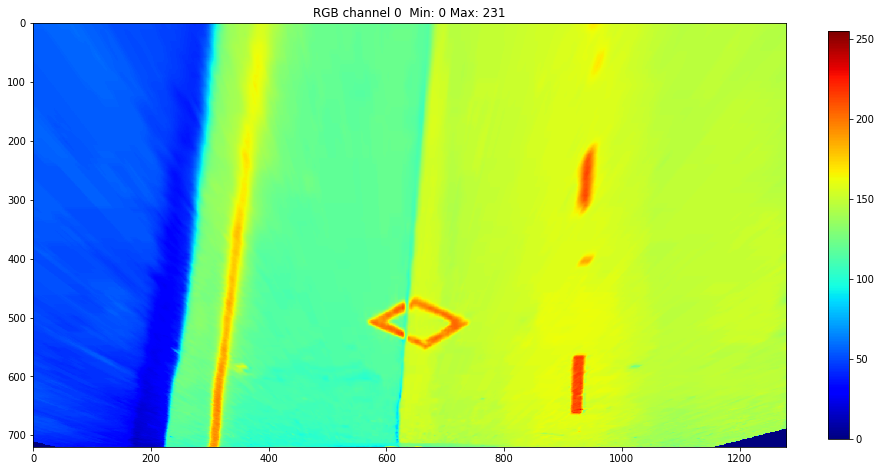

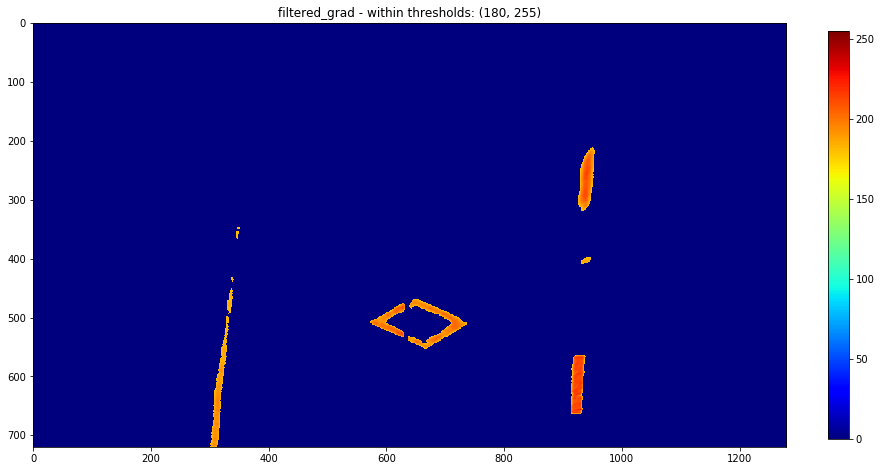

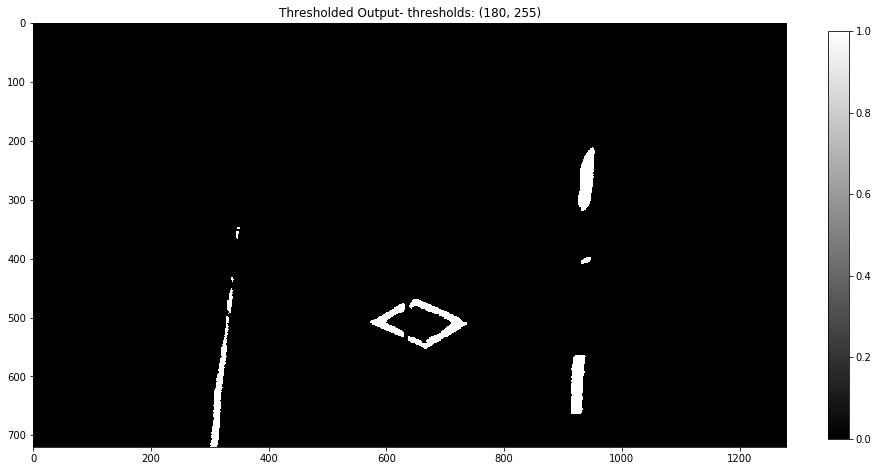

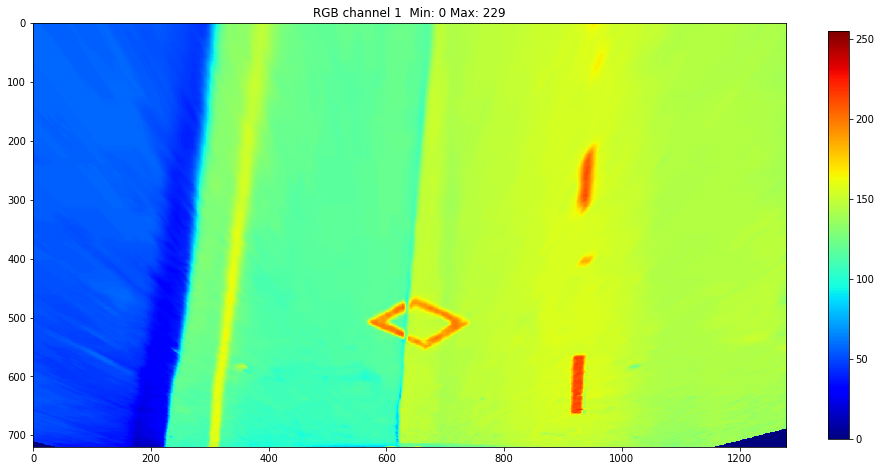

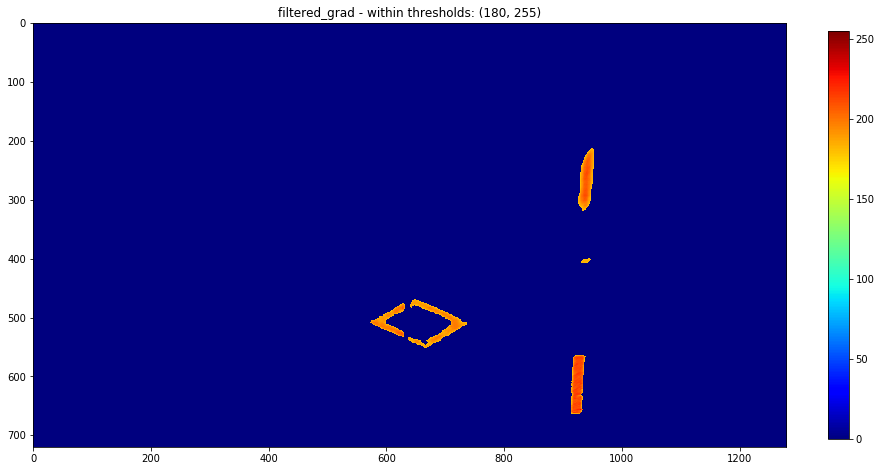

...

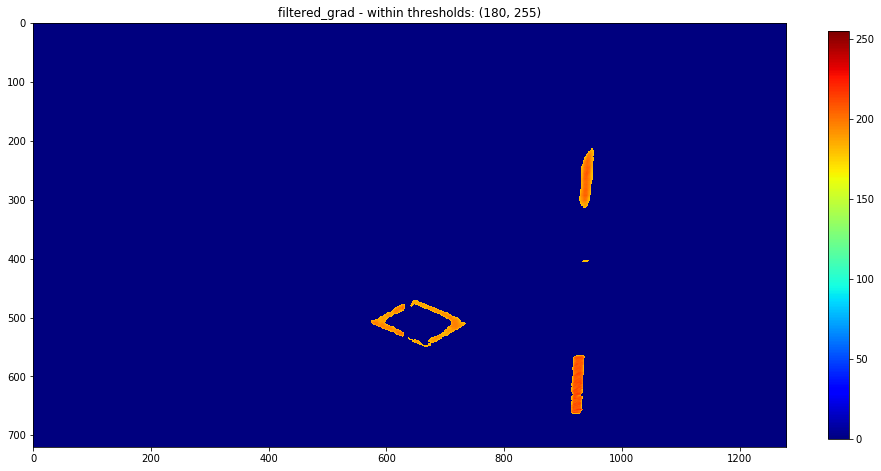

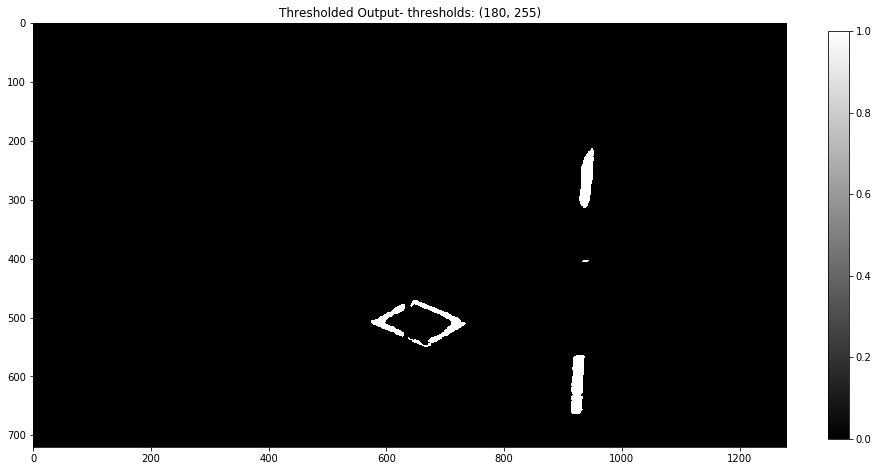

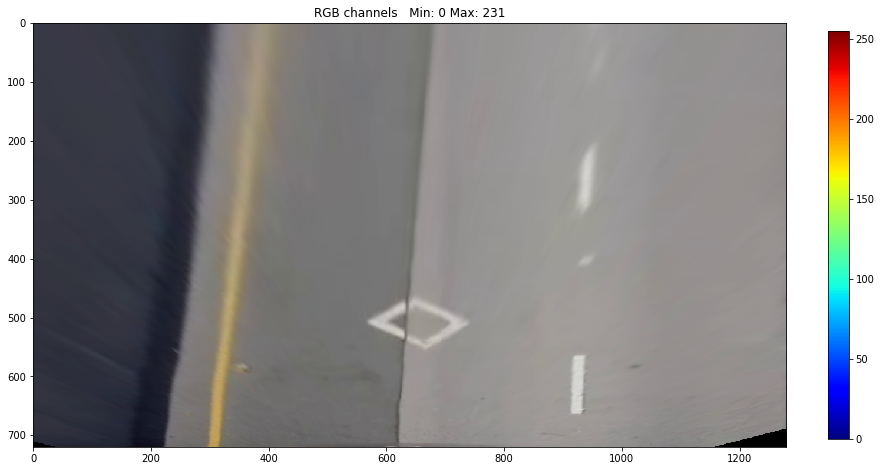

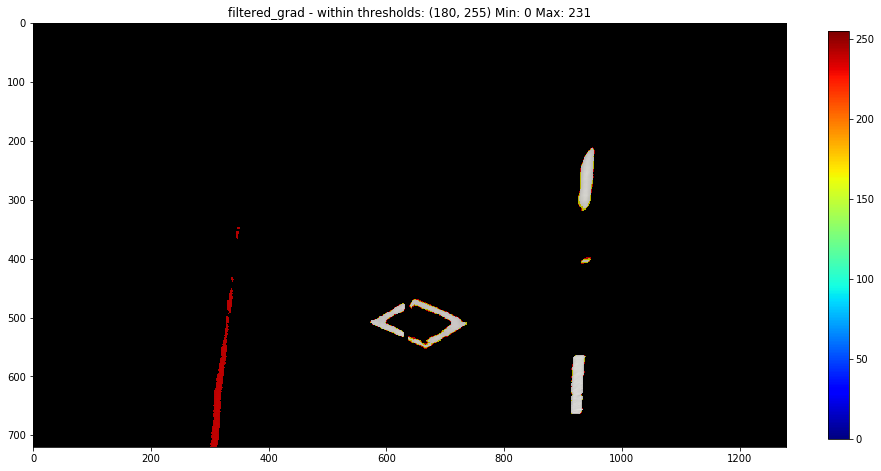

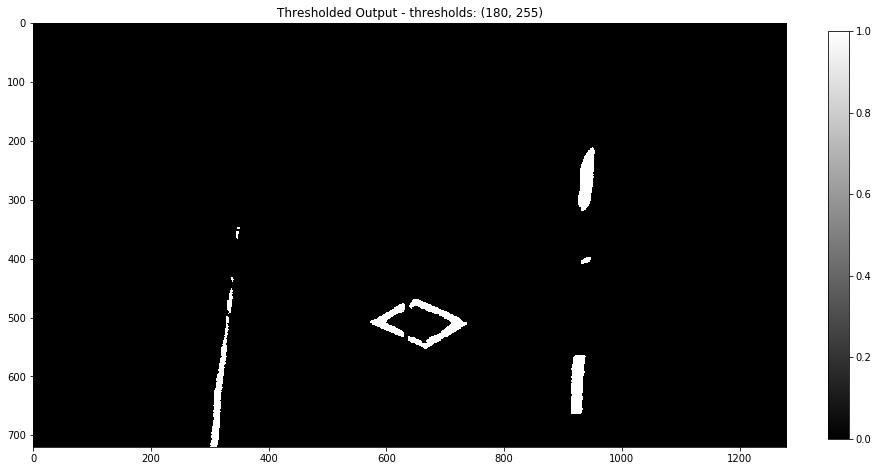

In [40]:
from common.sobel import *
test_rgb_thr = (180, 255)
rgb_binary   = RGB_thresh(img_to_process, thresh=test_rgb_thr,  display = True)
# display_one_cbar(s_binary, title = ' RGB Thresholding '+str(rgb_thr) )    

# Applying Multiple Thresholds 

In [77]:
from common.sobel import apply_thresholds

####  T1

In [462]:
# ksize = 19 # Choose a larger odd number to smooth gradient measurements
# grad_x_thr = (70,100)
# grad_y_thr = (80,155)
# mag_thr    = (90,160)
# theta1     = 45
# theta2     = 67

# ksize      = 5
# grad_x_thr = (30,110)
# grad_y_thr = (30,110)
# mag_thr    = (65,255)
# dir_thr    = (40,65)
# sat_thr    = (90,255)

#--adjusted for challenge video -------------=
ksize      = 7
test_grad_x_thr = (30,255)
test_grad_y_thr = (70,255)
test_mag_thr    = (35,255)
test_dir_thr    = (40,65)
test_sat_thr    = (80,255)
test_lvl_thr    = (180,255)
test_rgb_thr    = (180,255)
test_rgb_or_thr = (180,255)
# sat_thr    = (100,255)
#-------------------------------------------=

In [463]:
# from common.utils import *
# blurKernel = 7
# imgBlurred = gaussian_blur(image, blurKernel)

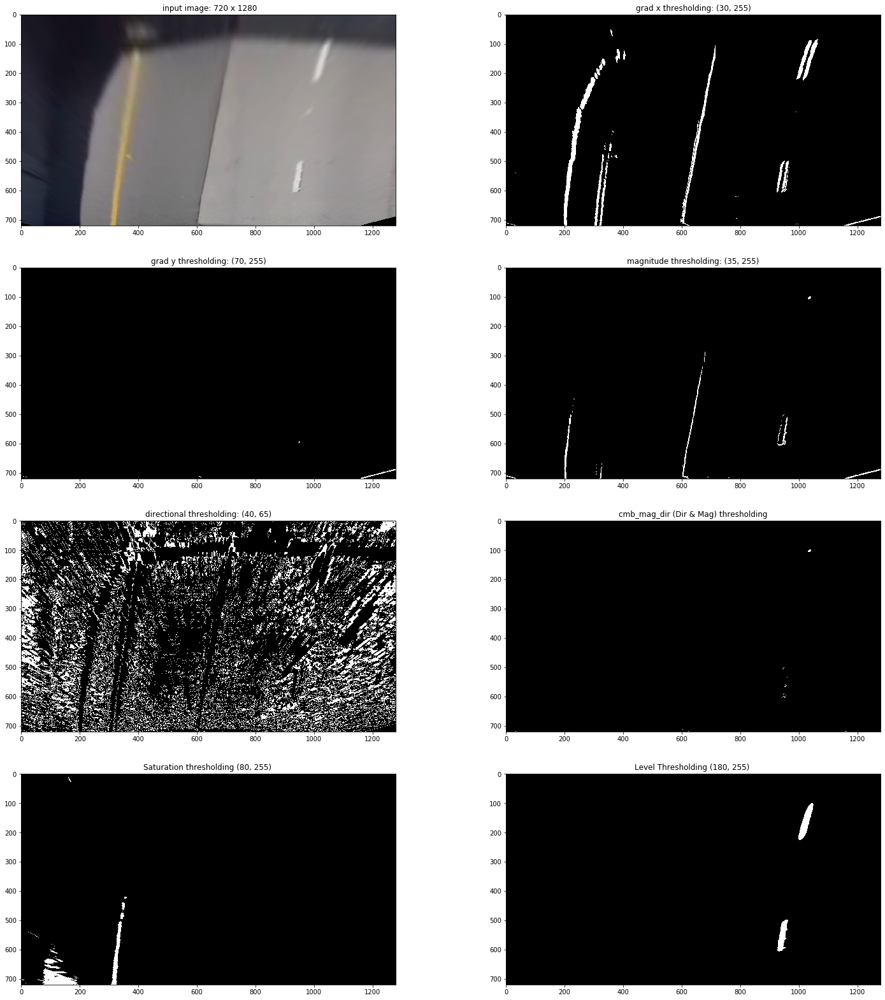

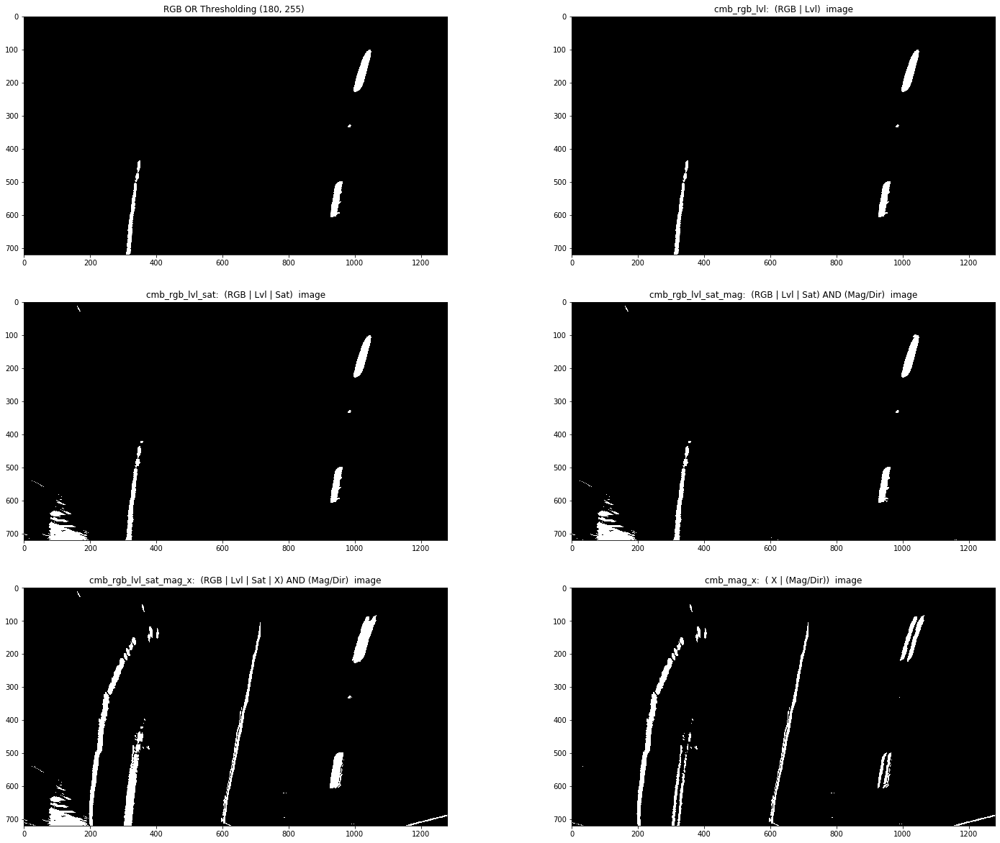

In [466]:
img_to_process = imgWarped
# T1 = apply_thresholds(imgBlurred, ksize=ksize, x_thr = grad_x_thr, y_thr = grad_y_thr, 
#                         mag_thr = mag_thr, dir_thr = dir_thr, sat_thr = sat_thr, 
#                         lvl_thr = lvl_thr, rgb_thr = rgb_thr, debug = True);

T1 = apply_thresholds(img_to_process, ret = 'cmb_rgb_lvl_sat', ksize = ksize, debug = True,
                                       x_thr = test_grad_x_thr, y_thr = test_grad_y_thr, 
                                     mag_thr = test_mag_thr   , dir_thr = test_dir_thr,  
                                     sat_thr = test_sat_thr   , rgb_thr = test_rgb_thr,  
                                     lvl_thr = test_lvl_thr)


####  T2

In [ ]:
# mag_thr    = (35,255), dir_thr    = (40,65),  sat_thr    = (65,255)
    ## dark conditions--------------

#--adjusted for challenge video -------------=
ksize      = 7
# mag_thr = (50,255), dir_thr = (0,10), sat_thr = (80, 255), 
test_grad_x_thr = (30,255)
test_grad_y_thr = (70,255)
# test_mag_thr    = (10,50) 
# test_dir_thr    = (5,25)  

# test_mag_thr    = (40,150) 
test_mag_thr    = (25,250) 
test_dir_thr    = (0,30)

# test_sat_thr    = (70, 255)
# test_lvl_thr    = (180,255)
# test_rgb_thr    = (180,255)

test_sat_thr    = (110, 255)
#-------------------------------
# sat_thr    = (70, 255)
# lvl_thr    = (180, 255)
# rgb_thr    = (180,255)
test_lvl_thr    = (205, 255)
test_rgb_thr   = (205,255)
##----------------------------------

In [25]:
# WarpedNormalThresholds = {
#             'ksize'      : 7         , 
#             'x_thr'      : (30,255)  ,
#             'y_thr'      : (70,255)  ,
#             'mag_thr'    : (10,50)   ,
#             'dir_thr'    : (0,30)    ,
#             'sat_thr'    : (80, 255) ,
#             'lvl_thr'    : (180,255) ,
#             'rgb_thr'    : (180,255) 
# }

In [78]:
WarpedNormalThresholds = {
    'ksize'      : 7         , 
    'x_thr'      : (30,255)  ,
    'y_thr'      : (70,255)  ,
    'mag_thr'    : (10,50)   ,
    'dir_thr'    : (0,30)    ,
    'sat_thr'    : (60, 255) ,
    'lvl_thr'    : (180,255) ,
    'rgb_thr'    : (180,255) 
}

WarpedDarkThresholds = {
    'ksize'      : 7         ,
    'x_thr'      : (70,255)  ,
    'y_thr'      : (70,255)  ,
    'mag_thr'    : (5,100)  ,
    'dir_thr'    : (0,30)    ,
    'sat_thr'    : (130,255) ,
    'lvl_thr'    : (200,255) ,
    'rgb_thr'    : (200,255)
}

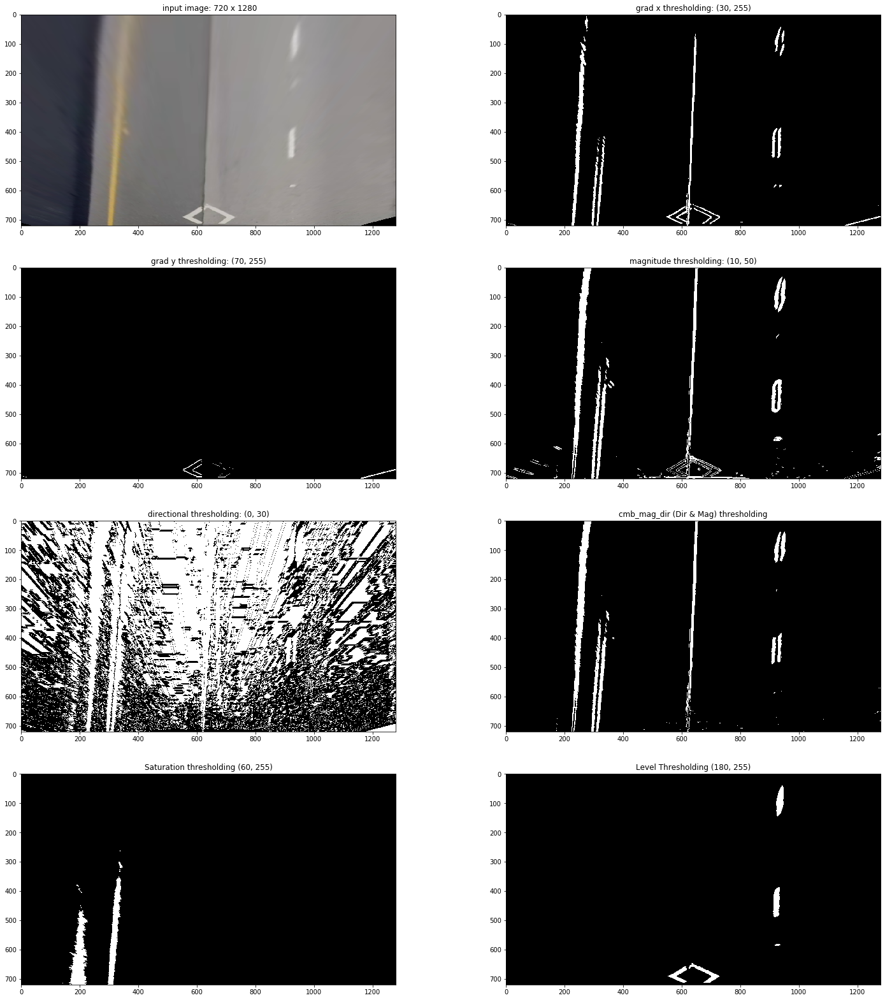

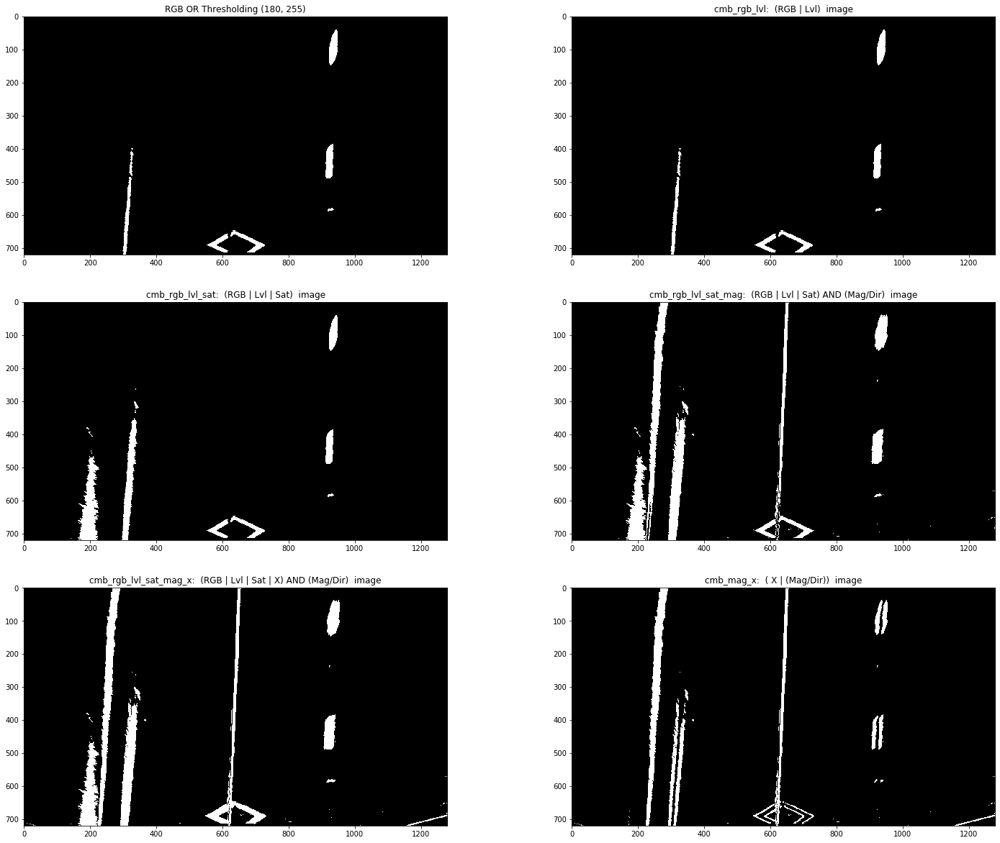

In [79]:
T2 = apply_thresholds(videoPipeline.imgWarped, WarpedNormalThresholds,debug = True)

In [299]:
# display_two(T1,T2)

In [283]:
# imgWarpedAdj = adjust_contrast(imgWarped, alpha = 0.7, beta = 0)
# display_two(imgWarped, imgWarpedAdj)
# display_one(videoPipeline.imgWarped)